In [1]:
!pwd

/data/tsubosaka/integrated_data/論文用再検討/修正/fig作成用


In [533]:
!ls \
A1CF_regulon.tsv

A1CF_regulon.tsv


In [2]:
import scanpy as sc

In [3]:
import os
import numpy as np
import pandas as pd
import loompy as lp


In [13]:
from MulticoreTSNE import MulticoreTSNE as TSNE

In [15]:
adata = sc.read_loom('./trial3_men.loom')

In [16]:
import seaborn as sns
import matplotlib.pyplot as plt

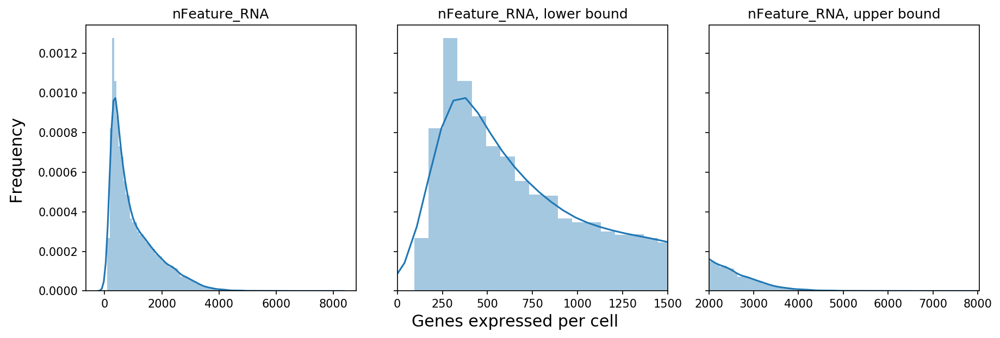

In [17]:
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(12, 4), dpi=150, sharey=True)

x = adata.obs['nFeature_RNA']
x_lowerbound = 1500
x_upperbound = 2000
nbins=100

sns.distplot(x, ax=ax1, norm_hist=True, bins=nbins)
sns.distplot(x, ax=ax2, norm_hist=True, bins=nbins)
sns.distplot(x, ax=ax3, norm_hist=True, bins=nbins)

ax2.set_xlim(0,x_lowerbound)
ax3.set_xlim(x_upperbound, adata.obs['nFeature_RNA'].max() )

for ax in (ax1,ax2,ax3): 
  ax.set_xlabel('')

ax1.title.set_text('nFeature_RNA')
ax2.title.set_text('nFeature_RNA, lower bound')
ax3.title.set_text('nFeature_RNA, upper bound')

fig.text(-0.01, 0.5, 'Frequency', ha='center', va='center', rotation='vertical', size='x-large')
fig.text(0.5, 0.0, 'Genes expressed per cell', ha='center', va='center', size='x-large')

fig.tight_layout()

In [18]:
adata

AnnData object with n_obs × n_vars = 26279 × 33538
    obs: 'CytoTRACE', 'G2M.Score', 'Phase', 'RNA_snn_res.0.5', 'RNA_snn_res.0.7', 'RNA_snn_res.0.8', 'S.Score', 'TN', 'bcds_score', 'cells.use', 'celltype_singleR', 'contami_frac', 'cxds_score', 'hybrid_score', 'ident', 'institution', 'major_clusters', 'nCount_RNA', 'nFeature_RNA', 'orig.ident', 'patient', 'percent.mt', 'replicate', 'seurat_clusters', 'sex', 'subcluster', 'subtype'
    layers: 'counts'

In [65]:
mat = pd.read_csv('./UMAP_men_coordinates.csv')

In [66]:
adata

AnnData object with n_obs × n_vars = 26279 × 33538
    obs: 'CytoTRACE', 'G2M.Score', 'Phase', 'RNA_snn_res.0.5', 'RNA_snn_res.0.7', 'RNA_snn_res.0.8', 'S.Score', 'TN', 'bcds_score', 'cells.use', 'celltype_singleR', 'contami_frac', 'cxds_score', 'hybrid_score', 'ident', 'institution', 'major_clusters', 'nCount_RNA', 'nFeature_RNA', 'orig.ident', 'patient', 'percent.mt', 'replicate', 'seurat_clusters', 'sex', 'subcluster', 'subtype'
    layers: 'counts'

In [21]:
f_anndata_path = "anndata.h5ad"

In [22]:
f_pyscenic_output = "pyscenic_output.loom"

In [23]:
sc.settings.njobs = 20

In [24]:
sc.set_figure_params(dpi=150, fontsize=10, dpi_save=600)

In [74]:
adata = sc.read_loom('./FBtrial.loom')

In [51]:
adata.var.index

Index(['MIR1302-2HG', 'FAM138A', 'OR4F5', 'AL627309.1', 'AL627309.3',
       'AL627309.2', 'AL627309.4', 'AL732372.1', 'OR4F29', 'AC114498.1',
       ...
       'AC007325.2', 'BX072566.1', 'AL354822.1', 'AC023491.2', 'AC004556.1',
       'AC233755.2', 'AC233755.1', 'AC240274.1', 'AC213203.1', 'FAM231C'],
      dtype='object', length=33538)

In [52]:
adata.obs['subcluster']

Stanford_5846N1-total_AAACCTGCAATGGATA             Chief
Stanford_5846N1-total_AAAGATGGTTCCACAA          PG/Neck1
Stanford_5846N1-total_AAATGCCGTTCACCTC             GKN+F
Stanford_5846N1-total_AAATGCCTCTATCCCG          PG/Neck1
Stanford_5846N1-total_AACTCCCAGCATCATC          PG/Neck2
                                                ...     
Tsinghua_12320058M-total_TTTGTCAAGGGAAACA    ADH1+GKN1-F
Tsinghua_12320058M-total_TTTGTCACACTGTCGG       PG/Neck1
Tsinghua_12320058M-total_TTTGTCACAGTTCCCT          GKN+F
Tsinghua_12320058M-total_TTTGTCAGTGGTAACG       PG/Neck1
Tsinghua_12320058M-total_TTTGTCAGTGTGAAAT         Pr_epi
Name: subcluster, Length: 26279, dtype: object

In [53]:
# create basic row and column attributes for the loom file:
row_attrs = {
    "Gene": np.array(adata.var.index) ,
}
col_attrs = {
    "CellID": np.array(adata.obs.index) ,
    "nGene": np.array( np.sum(adata.X.transpose()>0 , axis=0)).flatten() ,
    "nUMI": np.array( np.sum(adata.X.transpose() , axis=0)).flatten() ,
}

In [55]:
lp.create('filtered_men.loom', adata.X.transpose(), row_attrs,col_attrs)

In [25]:
f_tfs = "../allTFs_hg38.txt" # human

In [67]:
mat.index = mat.iloc[:,0]

In [68]:
mat2 = mat.iloc[:,1:]

In [ ]:
adata

In [ ]:
mat2

In [69]:
adata.X

<26279x33538 sparse matrix of type '<class 'numpy.float32'>'
	with 26929289 stored elements in Compressed Sparse Row format>

In [70]:
adata.obsm['X_umap'] = mat2

... storing 'Phase' as categorical
... storing 'RNA_snn_res.0.5' as categorical
... storing 'TN' as categorical
... storing 'celltype_singleR' as categorical
... storing 'ident' as categorical
... storing 'institution' as categorical
... storing 'orig.ident' as categorical
... storing 'patient' as categorical
... storing 'replicate' as categorical
... storing 'subcluster' as categorical
... storing 'subtype' as categorical


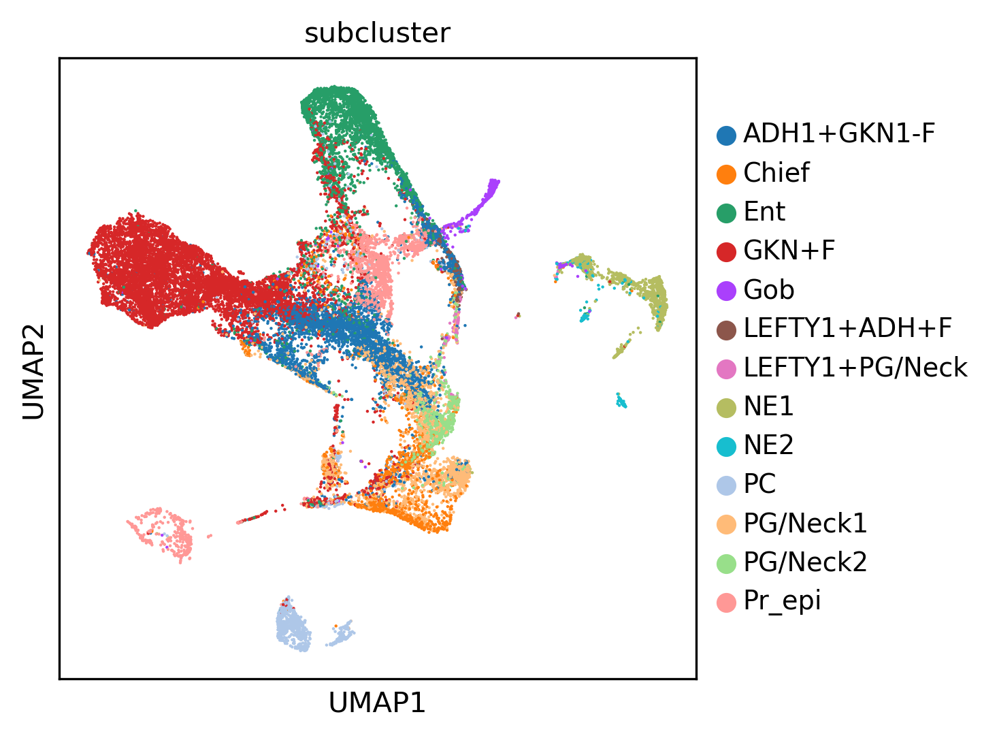

In [71]:
sc.pl.umap(adata, color=['subcluster'] )

In [28]:
adata.write( f_anndata_path )

In [58]:
from arboreto.utils import load_tf_names

In [59]:
tf_names = load_tf_names( f_tfs )

In [95]:
!pyscenic grn filtered_men.loom {f_tfs} -o adj_men.csv --transpose --num_workers 20 


2021-10-08 12:58:55,414 - pyscenic.cli.pyscenic - INFO - Loading expression matrix.
Traceback (most recent call last):
  File "/home/tsubosaka/anaconda3/bin/pyscenic", line 8, in <module>
    sys.exit(main())
  File "/home/tsubosaka/anaconda3/lib/python3.7/site-packages/pyscenic/cli/pyscenic.py", line 675, in main
    args.func(args)
  File "/home/tsubosaka/anaconda3/lib/python3.7/site-packages/pyscenic/cli/pyscenic.py", line 61, in find_adjacencies_command
    args.gene_attribute,
  File "/home/tsubosaka/anaconda3/lib/python3.7/site-packages/pyscenic/cli/utils.py", line 129, in load_exp_matrix
    return load_exp_matrix_as_loom(fname, return_sparse, attribute_name_cell_id, attribute_name_gene)
  File "/home/tsubosaka/anaconda3/lib/python3.7/site-packages/pyscenic/cli/utils.py", line 79, in load_exp_matrix_as_loom
    with lp.connect(fname, mode='r', validate=False) as ds:
  File "/home/tsubosaka/anaconda3/lib/python3.7/site-packages/loompy/loompy.py", line 1389, in connect
    return

In [86]:
adjacencies = pd.read_csv("adj_men.csv", index_col=False, sep='\')

In [87]:
adjacencies.shape

(4785551, 3)

In [90]:
!pwd

/data/tsubosaka/integrated_data/論文用再検討/修正/fig作成用


In [97]:
!pyscenic ctx adj_men.csv ../scenic/hg38__refseq-r80__10kb_up_and_down_tss.mc9nr.feather \
--annotations_fname ../scenic/motifs-v9-nr.hgnc-m0.001-o0.0.tbl \
--expression_mtx_fname filtered_men.loom \
--output reg_men.csv --num_workers 15 \
--mask_dropouts


2021-10-08 12:59:43,436 - pyscenic.cli.pyscenic - INFO - Creating modules.

2021-10-08 12:59:45,578 - pyscenic.cli.pyscenic - INFO - Loading expression matrix.

2021-10-08 13:00:02,329 - pyscenic.utils - INFO - Calculating Pearson correlations.

2021-10-08 13:00:03,674 - pyscenic.utils - WARNING - Note on correlation calculation: the default behaviour for calculating the correlations has changed after pySCENIC verion 0.9.16. Previously, the default was to calculate the correlation between a TF and target gene using only cells with non-zero expression values (mask_dropouts=True). The current default is now to use all cells to match the behavior of the R verision of SCENIC. The original settings can be retained by setting 'rho_mask_dropouts=True' in the modules_from_adjacencies function, or '--mask_dropouts' from the CLI.
	Dropout masking is currently set to [True].
/home/tsubosaka/anaconda3/lib/python3.7/site-packages/pyscenic/utils.py:147: RuntimeWarning: invalid value encountered in 

In [98]:
1+11

12

!pyscenic aucell --help

In [99]:
!pyscenic aucell \
filtered_men.loom \
reg_men.csv \
--output men_trial_SCENIC.loom \
--num_workers 15


2021-10-08 13:21:08,780 - pyscenic.cli.pyscenic - INFO - Loading expression matrix.

2021-10-08 13:21:19,816 - pyscenic.cli.pyscenic - INFO - Loading gene signatures.
Create regulons from a dataframe of enriched features.
Additional columns saved: []

2021-10-08 13:21:35,030 - pyscenic.cli.pyscenic - INFO - Calculating cellular enrichment.

2021-10-08 13:24:09,698 - pyscenic.cli.pyscenic - INFO - Writing results to file.


In [100]:
import llvmlite

# Visualization of SCENIC's AUC matrix

In [101]:
import json
import zlib
import base64


auc_mtx = pd.read_csv('FBtrial_SCENIC.csv')

auc_mtx.index=auc_mtx['Cell']

auc_mtx = auc_mtx.iloc[:,1:]

auc_mtx

In [102]:

# collect SCENIC AUCell output
lf = lp.connect('men_trial_SCENIC.loom', mode='r+', validate=False )
auc_mtx = pd.DataFrame( lf.ca.RegulonsAUC, index=lf.ca.CellID)
lf.close()

In [103]:
# tSNE
tsne = TSNE( n_jobs=20 )
dr_tsne = tsne.fit_transform( auc_mtx )
pd.DataFrame(dr_tsne, columns=['X', 'Y'], index=auc_mtx.index).to_csv( "scenic_tsne.txt", sep='\t')

In [104]:
import umap

# UMAP
runUmap = umap.UMAP(n_neighbors=10, min_dist=0.4, metric='correlation').fit_transform
dr_umap = runUmap( auc_mtx )
pd.DataFrame(dr_umap, columns=['X', 'Y'], index=auc_mtx.index).to_csv( "scenic_umap.txt", sep='\t')


In [69]:
# tSNE
tsne = TSNE( n_jobs=20 )
dr_tsne = tsne.fit_transform( auc_mtx )
pd.DataFrame(dr_tsne, columns=['X', 'Y'], index=auc_mtx.index).to_csv( "scenic_tsne.txt", sep='\t')

In [105]:
# scenic output
lf = lp.connect( 'men_trial_SCENIC.loom', mode='r+', validate=False )
meta = json.loads(zlib.decompress(base64.b64decode( lf.attrs.MetaData )))
#exprMat = pd.DataFrame( lf[:,:], index=lf.ra.Gene, columns=lf.ca.CellID)
auc_mtx = pd.DataFrame( lf.ca.RegulonsAUC, index=lf.ca.CellID)
regulons = lf.ra.Regulons
dr_umap = pd.read_csv( 'scenic_umap.txt', sep='\t', header=0, index_col=0 )

In [106]:
dr_tsne = pd.read_csv( 'scenic_tsne.txt', sep='\t', header=0, index_col=0 )

In [107]:
auc_mtx.head()

,AHCTF1(+),AR(+),ARID3A(+),ARNT(+),ARNTL2(+),ARX(+),ASCL1(+),ATF1(+),ATF3(+),ATF4(+),...,ZNF784(+),ZNF787(+),ZNF79(+),ZNF823(+),ZNF84(+),ZNF841(+),ZNF93(+),ZSCAN16(+),ZSCAN9(+),ZXDA(+)
Stanford_5846N1-total_AAACCTGCAATGGATA,0.027535,0.000000,0.000000,0.047890,0.052159,0.004868,0.019824,0.000000,0.108298,0.091094,...,0.000000,0.040630,0.035614,0.060823,0.112962,0.014264,0.097841,0.157173,0.00000,0.0
Stanford_5846N1-total_AAAGATGGTTCCACAA,0.000000,0.072664,0.033542,0.037558,0.185380,0.001876,0.000000,0.099637,0.176029,0.167648,...,0.074339,0.045617,0.066251,0.000000,0.104018,0.018223,0.170185,0.048928,0.00000,0.0
Stanford_5846N1-total_AAATGCCGTTCACCTC,0.048195,0.000000,0.073246,0.055085,0.081939,0.028796,0.013605,0.005719,0.086171,0.070288,...,0.000000,0.018357,0.032447,0.104800,0.054394,0.041860,0.000000,0.042808,0.00000,0.0
Stanford_5846N1-total_AAATGCCTCTATCCCG,0.039286,0.000000,0.043679,0.049212,0.140201,0.025576,0.013581,0.044831,0.127199,0.112984,...,0.000000,0.027167,0.048876,0.000000,0.030169,0.000000,0.086798,0.022440,0.04566,0.0
Stanford_5846N1-total_AACTCCCAGCATCATC,0.061314,0.000000,0.031256,0.045816,0.031639,0.025088,0.000000,0.021440,0.129107,0.128740,...,0.164281,0.043214,0.038246,0.000000,0.062444,0.021896,0.072797,0.046135,0.00000,0.0


In [108]:
auc_mtx.columns = auc_mtx.columns.str.replace('\(','_(')
regulons.dtype.names = tuple( [ x.replace("(","_(") for x in regulons.dtype.names ] )
# regulon thresholds
rt = meta['regulonThresholds']
for i,x in enumerate(rt):
    tmp = x.get('regulon').replace("(","_(")
    x.update( {'regulon': tmp} )

In [109]:
from MulticoreTSNE import MulticoreTSNE as TSNE

In [111]:
#tsneDF = pd.DataFrame(adata.obsm['X_tsne'], columns=['_X', '_Y'])

Embeddings_X = pd.DataFrame( index=lf.ca.CellID )
Embeddings_X = pd.concat( [
        pd.DataFrame(adata.obsm['X_umap'],index=adata.obs.index)['umap_1'] ,
        dr_umap['X']
    ], sort=False, axis=1, join='outer' )
Embeddings_X.columns = ['1','2']

Embeddings_Y = pd.DataFrame( index=lf.ca.CellID )
Embeddings_Y = pd.concat( [
        pd.DataFrame(adata.obsm['X_umap'],index=adata.obs.index)['umap_2'] ,
        dr_umap['Y']
    ], sort=False, axis=1, join='outer' )
Embeddings_Y.columns = ['1','2']

In [112]:
adata.obs

,CytoTRACE,G2M.Score,Phase,RNA_snn_res.0.5,RNA_snn_res.0.7,RNA_snn_res.0.8,S.Score,TN,bcds_score,cells.use,...,nCount_RNA,nFeature_RNA,orig.ident,patient,percent.mt,replicate,seurat_clusters,sex,subcluster,subtype
Stanford_5846N1-total_AAACCTGCAATGGATA,0.853586,-0.088388,G1,11,15,3,-0.017929,N,0.095405,1,...,2115.255255,857,Stanford_5846N1-total,5846,18.808205,1,8,1,Chief,DGC
Stanford_5846N1-total_AAAGATGGTTCCACAA,0.838645,-0.065238,G1,1,10,24,-0.139821,N,0.540508,1,...,4834.847370,2538,Stanford_5846N1-total,5846,22.800218,1,3,1,PG/Neck1,DGC
Stanford_5846N1-total_AAATGCCGTTCACCTC,0.001992,-0.054841,S,1,1,13,0.029940,N,0.134239,1,...,360.749482,267,Stanford_5846N1-total,5846,20.849322,1,1,1,GKN+F,DGC
Stanford_5846N1-total_AAATGCCTCTATCCCG,0.834661,-0.054932,G1,11,10,24,-0.059082,N,0.236302,1,...,3002.883371,1764,Stanford_5846N1-total,5846,1.793311,1,3,1,PG/Neck1,DGC
Stanford_5846N1-total_AACTCCCAGCATCATC,0.898406,-0.077130,G1,11,4,24,-0.070489,N,0.785795,1,...,4454.616983,1991,Stanford_5846N1-total,5846,0.837207,1,12,1,PG/Neck2,DGC
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Tsinghua_12320058M-total_TTTGTCAAGGGAAACA,0.238048,-0.094939,S,1,14,13,0.013489,N,0.219643,1,...,754.907878,556,Tsinghua_12320058M-total,NAG3,1.903953,1,7,1,ADH1+GKN1-F,NAG
Tsinghua_12320058M-total_TTTGTCACACTGTCGG,0.907371,-0.026286,S,11,10,3,0.110039,N,0.015001,1,...,480.934188,452,Tsinghua_12320058M-total,NAG3,8.985166,1,3,1,PG/Neck1,NAG
Tsinghua_12320058M-total_TTTGTCACAGTTCCCT,0.044821,-0.048875,G1,1,1,13,-0.046340,N,0.017665,1,...,562.213252,395,Tsinghua_12320058M-total,NAG3,10.283455,1,1,1,GKN+F,NAG
Tsinghua_12320058M-total_TTTGTCAGTGGTAACG,0.675299,-0.060579,S,11,10,24,0.054086,N,0.005579,1,...,394.608389,331,Tsinghua_12320058M-total,NAG3,9.702896,1,3,1,PG/Neck1,NAG


In [113]:
### metadata
metaJson = {}

metaJson['embeddings'] = [
    {
        "id": 1,
        "name": "monocle3 umap"
    },
    {
        "id": 2,
        "name": "SCENIC AUC UMAP"
    },
]


# SCENIC regulon thresholds:


In [114]:
metaJson["regulonThresholds"] = rt

In [115]:
def dfToNamedMatrix(df):
    arr_ip = [tuple(i) for i in df.values]
    dtyp = np.dtype(list(zip(df.dtypes.index, df.dtypes)))
    arr = np.array(arr_ip, dtype=dtyp)
    return arr

In [116]:
col_attrs = {
    "CellID": np.array(adata.obs.index),
  #  "nUMI": np.array(adata.obs['n_counts'].values),
   # "nGene": np.array(adata.obs['n_genes'].values),
    #"Louvain_clusters_Scanpy": np.array( adata.obs['louvain'].values ),
    #"Genotype": np.array(adata.obs['Genotype'].values),
    #"Timepoint": np.array(adata.obs['Timepoint'].values),
    #"Sample": np.array(adata.obs['Sample'].values),
 #   "Percent_mito": np.array(adata.obs['percent_mito'].values),
 #   "Embedding": dfToNamedMatrix(tsneDF),
    "Embeddings_X": dfToNamedMatrix(Embeddings_X),
    "Embeddings_Y": dfToNamedMatrix(Embeddings_Y),
    "RegulonsAUC": dfToNamedMatrix(auc_mtx),
 #   "Clusterings": dfToNamedMatrix(clusterings),
  #  "ClusterID": np.array(adata.obs['louvain'].values)
}

row_attrs = {
    "Gene": lf.ra.Gene,
    "Regulons": regulons,
}

attrs = {
    "title": "sampleTitle",
    "MetaData": json.dumps(metaJson),
    "Genome": 'hg38',
    "SCopeTreeL1": "",
    "SCopeTreeL2": "",
    "SCopeTreeL3": ""
}

# compress the metadata field:
attrs['MetaData'] = base64.b64encode(zlib.compress(json.dumps(metaJson).encode('ascii'))).decode('ascii')

In [117]:
lp.create(
    filename = 'epi_men.loom' ,
    layers=lf[:,:],
    row_attrs=row_attrs, 
    col_attrs=col_attrs, 
    file_attrs=attrs
)
lf.close() # close original pyscenic loom file

In [118]:
# import dependencies
import os
import numpy as np
import pandas as pd
import scanpy as sc
import loompy as lp
from MulticoreTSNE import MulticoreTSNE as TSNE
import json
import base64
import zlib
from pyscenic.plotting import plot_binarization
from pyscenic.export import add_scenic_metadata
from pyscenic.cli.utils import load_signatures
import matplotlib as mpl
import matplotlib.pyplot as plt
#from scanpy.plotting._tools.scatterplots import plot_scatter
import seaborn as sns

In [119]:
1+1

2

In [123]:
f_final_loom = 'epi_men.loom'

In [121]:
sc.settings.verbosity = 3 # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_versions()
sc.settings.set_figure_params(dpi=150)

scanpy==1.5.1 anndata==0.7.3 umap==0.4.2 numpy==1.18.1 scipy==1.4.1 pandas==1.0.1 scikit-learn==0.24.2 statsmodels==0.11.0 python-igraph==0.7.1 louvain==0.6.1


In [124]:
# scenic output
lf = lp.connect( f_final_loom, mode='r', validate=False )
meta = json.loads(zlib.decompress(base64.b64decode( lf.attrs.MetaData )))
exprMat = pd.DataFrame( lf[:,:], index=lf.ra.Gene, columns=lf.ca.CellID).T
auc_mtx = pd.DataFrame( lf.ca.RegulonsAUC, index=lf.ca.CellID)

In [125]:
# create a dictionary of regulons:
regulons = {}
for i,r in pd.DataFrame(lf.ra.Regulons,index=lf.ra.Gene).iteritems():
    regulons[i] =  list(r[r==1].index.values)

In [129]:
lf.ca.keys()

['CellID', 'Embeddings_X', 'Embeddings_Y', 'RegulonsAUC']

In [130]:
cellAnnot = pd.concat(
    [
#        pd.DataFrame( lf.ca.Celltype_Garnett, index=lf.ca.CellID ),
#        pd.DataFrame( lf.ca.ClusterID, index=lf.ca.CellID ),
        pd.DataFrame( lf.ca.Louvain_clusters_Scanpy, index=lf.ca.CellID ),
        pd.DataFrame( lf.ca.Percent_mito, index=lf.ca.CellID ),
        pd.DataFrame( lf.ca.nGene, index=lf.ca.CellID ),
        pd.DataFrame( lf.ca.nUMI, index=lf.ca.CellID ),
    ],
    axis=1
)
cellAnnot.columns = [
 'Celltype_Garnett',
# 'ClusterID',
 'Louvain_clusters_Scanpy',
 'Percent_mito',
 'nGene',
 'nUMI']

AttributeError: '<class 'loompy.attribute_manager.AttributeManager'>' object has no attribute 'Louvain_clusters_Scanpy'

In [ ]:
lf.ca.keys()

In [132]:
lf.close()


In [131]:
# load the regulons from a file using the load_signatures function
sig = load_signatures('reg_men.csv')
adata = add_scenic_metadata(adata, auc_mtx, sig)

Create regulons from a dataframe of enriched features.
Additional columns saved: []


In [133]:
# helper functions (not yet integrated into pySCENIC):

from pyscenic.utils import load_motifs
import operator as op
from IPython.display import HTML, display

BASE_URL = "http://motifcollections.aertslab.org/v9/logos/"
COLUMN_NAME_LOGO = "MotifLogo"
COLUMN_NAME_MOTIF_ID = "MotifID"
COLUMN_NAME_TARGETS = "TargetGenes"

def display_logos(df: pd.DataFrame, top_target_genes: int = 3, base_url: str = BASE_URL):
    """
    :param df:
    :param base_url:
    """
    # Make sure the original dataframe is not altered.
    df = df.copy()
    
    # Add column with URLs to sequence logo.
    def create_url(motif_id):
        return '<img src="{}{}.png" style="max-height:124px;"></img>'.format(base_url, motif_id)
    df[("Enrichment", COLUMN_NAME_LOGO)] = list(map(create_url, df.index.get_level_values(COLUMN_NAME_MOTIF_ID)))
    
    # Truncate TargetGenes.
    def truncate(col_val):
        return sorted(col_val, key=op.itemgetter(1))[:top_target_genes]
    df[("Enrichment", COLUMN_NAME_TARGETS)] = list(map(truncate, df[("Enrichment", COLUMN_NAME_TARGETS)]))
    
    MAX_COL_WIDTH = pd.get_option('display.max_colwidth')
    pd.set_option('display.max_colwidth', 200)
    display(HTML(df.head().to_html(escape=False)))
    pd.set_option('display.max_colwidth', MAX_COL_WIDTH)

In [134]:
df_motifs = load_motifs('reg_men.csv')

In [135]:
selected_motifs = ['PAX5','TCF3','EBF1']
df_motifs_sel = df_motifs.iloc[ [ True if x in selected_motifs else False for x in df_motifs.index.get_level_values('TF') ] ,:]


In [136]:
#display_logos(df_motifs.head())
display_logos( df_motifs_sel.sort_values([('Enrichment','NES')], ascending=False).head(9))

In [137]:
def colorMap( x, palette='bright' ):
    import natsort
    from collections import OrderedDict
    #
    n=len(set(x))
    cpalette = sns.color_palette(palette,n_colors=n )
    cdict = dict( zip( list(set(x)), cpalette ))
    cmap = [ cdict[i] for i in x ]
    cdict = OrderedDict( natsort.natsorted(cdict.items()) )
    return cmap,cdict

def drplot( dr, colorlab, ax, palette='bright', title=None, **kwargs ):
    cmap,cdict = colorMap( colorlab, palette )
    for lab,col in cdict.items():  
        ix = colorlab.loc[colorlab==lab].index
        ax.scatter( dr['X'][ix], dr['Y'][ix], c=[col]*len(ix), alpha=0.7, label=lab, edgecolors='none')
    if( title is not None ):
        ax.set_title(title, fontsize='x-large');
    #
    ax.set_xticks([])
    ax.set_yticks([])
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)

In [138]:
lf

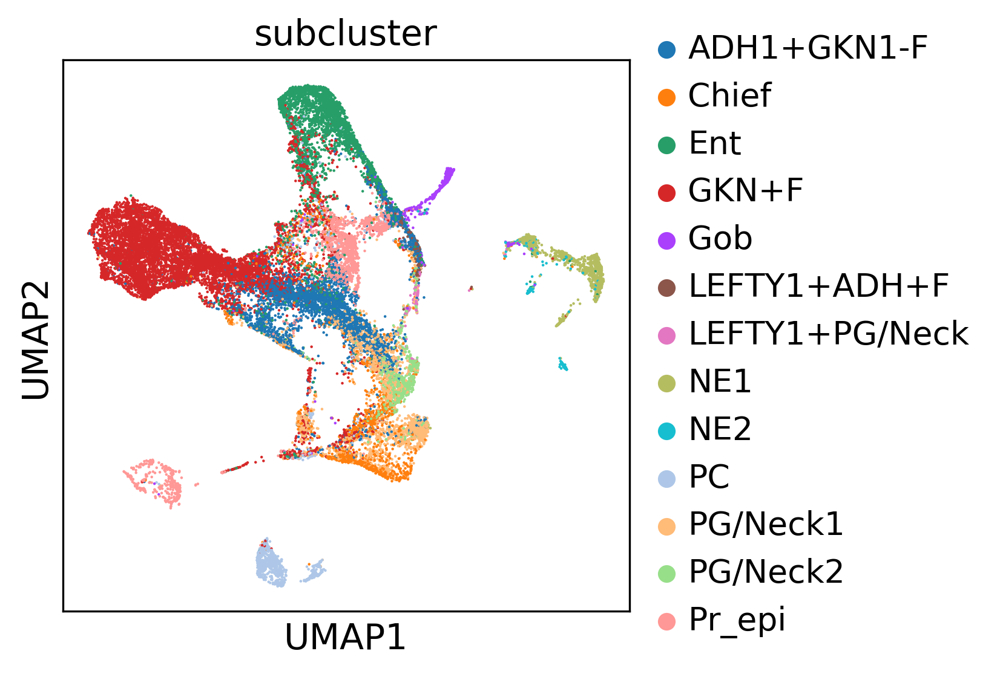

In [139]:
sc.pl.umap(adata, color=['subcluster'] )

In [26]:
adata.obs

,CytoTRACE,G2M.Score,Phase,RNA_snn_res.0.5,RNA_snn_res.0.7,RNA_snn_res.0.8,S.Score,TN,bcds_score,cells.use,...,Regulon(ZNF778(+)),Regulon(ZNF780A(+)),Regulon(ZNF789(+)),Regulon(ZNF799(+)),Regulon(ZNF813(+)),Regulon(ZNF831(+)),Regulon(ZNF841(+)),Regulon(ZNF853(+)),Regulon(ZNF90(+)),Regulon(ZNF93(+))
Stanford_5846N1-total_AACTCCCAGCATCATC,0.898406,-0.077130,G1,11,4,24,-0.070489,N,0.785795,1,...,0.000000,0.000000,0.033207,0.000000,0.000000,0.000000,0.170021,0.000000,0.000000,0.0
Stanford_5846N1-total_AACTGGTCAGCTGTAT,0.813745,-0.154364,G1,15,3,11,-0.080367,N,0.138766,1,...,0.060552,0.000000,0.128578,0.100626,0.038760,0.000000,0.000000,0.000000,0.000000,0.0
Stanford_5846N1-total_ACGCCAGAGCCACCTG,0.867530,-0.089581,G1,11,15,3,-0.029086,N,0.578422,1,...,0.053559,0.129756,0.070289,0.019231,0.000000,0.050686,0.000000,0.000000,0.000000,0.0
Stanford_5846N1-total_ACTGAACCAGTTAACC,0.571713,-0.059057,G1,4,3,3,-0.049654,N,0.086479,1,...,0.069496,0.000000,0.041108,0.133870,0.019593,0.000000,0.000000,0.000000,0.000000,0.0
Stanford_5846N1-total_ACTGAGTCACCATGTA,0.331673,-0.032017,G1,1,2,13,-0.064612,N,0.153860,1,...,0.154063,0.000000,0.052326,0.044723,0.068277,0.000000,0.000000,0.000000,0.111628,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Tsinghua_12320058M-total_TTTCCTCGTGTGGTTT,0.989044,-0.047430,G1,14,16,9,-0.062618,N,0.061232,1,...,0.000000,0.000000,0.047965,0.037120,0.056010,0.000000,0.000000,0.000000,0.000000,0.0
Tsinghua_12320058M-total_TTTGCGCGTGTTGGGA,0.117530,-0.024316,G1,1,1,13,-0.032972,N,0.103729,1,...,0.000000,0.000000,0.065370,0.189475,0.010648,0.000000,0.097421,0.000000,0.000000,0.0
Tsinghua_12320058M-total_TTTGGTTTCCGAAGAG,0.112550,-0.080971,G1,1,1,13,-0.005719,N,0.409970,1,...,0.066894,0.000000,0.053965,0.073196,0.002470,0.000000,0.000000,0.217501,0.000000,0.0
Tsinghua_12320058M-total_TTTGTCAGTGGTAACG,0.675299,-0.060579,S,11,10,24,0.054086,N,0.005579,1,...,0.000000,0.000000,0.047443,0.262895,0.023256,0.000000,0.000000,0.000000,0.181992,0.0


In [140]:
colors = ['#B13AE6','#7BE2CC','#84AED6','#7BE36F','#8775D7','#E26363','#D2E056','#DAD1D6','#DDA767','#DD5ACA','#D3E4AB','#D691BF','#7A8A74']

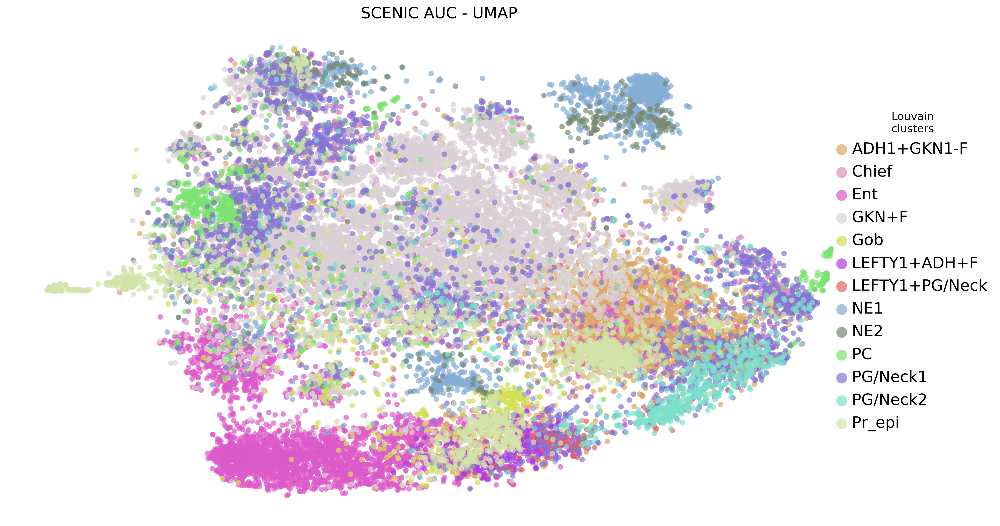

In [141]:
plt.rcParams.update({'font.size':12})

fig, ax2 = plt.subplots(figsize=(17,10), dpi=150 )

#drplot( dr_tsne, colorlab=adata.obs['subcluster'], ax=ax1, palette='bright', s=2, title='Highly variable genes - UMAP' )

drplot( dr_tsne, colorlab=adata.obs['subcluster'], ax=ax2, palette=colors,s=2, title='SCENIC AUC - UMAP' )
ax2.legend(loc='right', bbox_to_anchor=(1.15, 0.5), ncol=1, markerscale=2, fontsize='x-large', frameon=False, title="Louvain\nclusters")

#plt.tight_layout()
#plt.savefig("PBMC10k_dimred_umap-hvg-scenic-louvain.pdf", dpi=600, bbox_inches = "tight")

In [142]:
from pyscenic.rss import regulon_specificity_scores
from pyscenic.plotting import plot_rss
import matplotlib.pyplot as plt
from adjustText import adjust_text
import seaborn as sns
from pyscenic.binarization import binarize

In [143]:
lf.ca

In [144]:
lf.close()

In [145]:
auc_mtx.head()

,AHCTF1_(+),AR_(+),ARID3A_(+),ARNT_(+),ARNTL2_(+),ARX_(+),ASCL1_(+),ATF1_(+),ATF3_(+),ATF4_(+),...,ZNF784_(+),ZNF787_(+),ZNF79_(+),ZNF823_(+),ZNF84_(+),ZNF841_(+),ZNF93_(+),ZSCAN16_(+),ZSCAN9_(+),ZXDA_(+)
Stanford_5846N1-total_AAACCTGCAATGGATA,0.027535,0.000000,0.000000,0.047890,0.052159,0.004868,0.019824,0.000000,0.108298,0.091094,...,0.000000,0.040630,0.035614,0.060823,0.112962,0.014264,0.097841,0.157173,0.00000,0.0
Stanford_5846N1-total_AAAGATGGTTCCACAA,0.000000,0.072664,0.033542,0.037558,0.185380,0.001876,0.000000,0.099637,0.176029,0.167648,...,0.074339,0.045617,0.066251,0.000000,0.104018,0.018223,0.170185,0.048928,0.00000,0.0
Stanford_5846N1-total_AAATGCCGTTCACCTC,0.048195,0.000000,0.073246,0.055085,0.081939,0.028796,0.013605,0.005719,0.086171,0.070288,...,0.000000,0.018357,0.032447,0.104800,0.054394,0.041860,0.000000,0.042808,0.00000,0.0
Stanford_5846N1-total_AAATGCCTCTATCCCG,0.039286,0.000000,0.043679,0.049212,0.140201,0.025576,0.013581,0.044831,0.127199,0.112984,...,0.000000,0.027167,0.048876,0.000000,0.030169,0.000000,0.086798,0.022440,0.04566,0.0
Stanford_5846N1-total_AACTCCCAGCATCATC,0.061314,0.000000,0.031256,0.045816,0.031639,0.025088,0.000000,0.021440,0.129107,0.128740,...,0.164281,0.043214,0.038246,0.000000,0.062444,0.021896,0.072797,0.046135,0.00000,0.0


In [146]:
adata.obs['subcluster'].head()

Stanford_5846N1-total_AAACCTGCAATGGATA       Chief
Stanford_5846N1-total_AAAGATGGTTCCACAA    PG/Neck1
Stanford_5846N1-total_AAATGCCGTTCACCTC       GKN+F
Stanford_5846N1-total_AAATGCCTCTATCCCG    PG/Neck1
Stanford_5846N1-total_AACTCCCAGCATCATC    PG/Neck2
Name: subcluster, dtype: category
Categories (13, object): [ADH1+GKN1-F, Chief, Ent, GKN+F, ..., PC, PG/Neck1, PG/Neck2, Pr_epi]

In [147]:
cell_types = list(adata.obs['subcluster'].unique())
n_types = len(cell_types)
regulons = list(auc_mtx.columns)
n_regulons = len(regulons)
rss_values = np.empty(shape=(n_types, n_regulons), dtype=np.float)

In [148]:
from scipy.spatial.distance import jensenshannon
from math import sqrt


In [149]:
def rss(aucs, labels):
        # jensenshannon function provides distance which is the sqrt of the JS divergence.
        # Jensen-shannon distance のaucsのinput→平均値, 細胞種の割合
    return 1.0 - jensenshannon(aucs / aucs.sum(), labels / labels.sum())

In [151]:
auc_mtx

,AHCTF1_(+),AR_(+),ARID3A_(+),ARNT_(+),ARNTL2_(+),ARX_(+),ASCL1_(+),ATF1_(+),ATF3_(+),ATF4_(+),...,ZNF784_(+),ZNF787_(+),ZNF79_(+),ZNF823_(+),ZNF84_(+),ZNF841_(+),ZNF93_(+),ZSCAN16_(+),ZSCAN9_(+),ZXDA_(+)
Stanford_5846N1-total_AAACCTGCAATGGATA,0.027535,0.000000,0.000000,0.047890,0.052159,0.004868,0.019824,0.000000,0.108298,0.091094,...,0.000000,0.040630,0.035614,0.060823,0.112962,0.014264,0.097841,0.157173,0.00000,0.000000
Stanford_5846N1-total_AAAGATGGTTCCACAA,0.000000,0.072664,0.033542,0.037558,0.185380,0.001876,0.000000,0.099637,0.176029,0.167648,...,0.074339,0.045617,0.066251,0.000000,0.104018,0.018223,0.170185,0.048928,0.00000,0.000000
Stanford_5846N1-total_AAATGCCGTTCACCTC,0.048195,0.000000,0.073246,0.055085,0.081939,0.028796,0.013605,0.005719,0.086171,0.070288,...,0.000000,0.018357,0.032447,0.104800,0.054394,0.041860,0.000000,0.042808,0.00000,0.000000
Stanford_5846N1-total_AAATGCCTCTATCCCG,0.039286,0.000000,0.043679,0.049212,0.140201,0.025576,0.013581,0.044831,0.127199,0.112984,...,0.000000,0.027167,0.048876,0.000000,0.030169,0.000000,0.086798,0.022440,0.04566,0.000000
Stanford_5846N1-total_AACTCCCAGCATCATC,0.061314,0.000000,0.031256,0.045816,0.031639,0.025088,0.000000,0.021440,0.129107,0.128740,...,0.164281,0.043214,0.038246,0.000000,0.062444,0.021896,0.072797,0.046135,0.00000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Tsinghua_12320058M-total_TTTGTCAAGGGAAACA,0.137606,0.000000,0.000000,0.053153,0.087516,0.023440,0.010113,0.035182,0.093952,0.107749,...,0.000000,0.051685,0.073880,0.083259,0.065314,0.028312,0.060680,0.091391,0.00000,0.000000
Tsinghua_12320058M-total_TTTGTCACACTGTCGG,0.041776,0.000000,0.000000,0.055391,0.056754,0.009194,0.011366,0.001003,0.068571,0.061565,...,0.000000,0.021894,0.112311,0.091011,0.041760,0.033154,0.032916,0.037065,0.00000,0.187239
Tsinghua_12320058M-total_TTTGTCACAGTTCCCT,0.043741,0.000000,0.000000,0.028402,0.169771,0.025598,0.012036,0.002304,0.093624,0.101222,...,0.000000,0.025331,0.027183,0.095259,0.068761,0.073846,0.036494,0.038822,0.00000,0.000000
Tsinghua_12320058M-total_TTTGTCAGTGGTAACG,0.045950,0.000000,0.000000,0.057919,0.072784,0.026638,0.012814,0.047786,0.073568,0.077661,...,0.000000,0.034749,0.062386,0.100030,0.105490,0.074323,0.000000,0.090293,0.00000,0.000000


In [152]:
auc_mtx[regulon_name].sum()

3962.260981912145

In [154]:
cell_types

['Chief',
 'PG/Neck1',
 'GKN+F',
 'PG/Neck2',
 'PC',
 'Pr_epi',
 'ADH1+GKN1-F',
 'NE2',
 'NE1',
 'Ent',
 'Gob',
 'LEFTY1+PG/Neck',
 'LEFTY1+ADH+F']

In [155]:
np.sum(adata.obs['subcluster'] == cell_type).astype(int)

1585

In [156]:
# 各regulonごとに各細胞種のRSS (1-jensenshannon距離)を計算
rss_cellType = regulon_specificity_scores( auc_mtx,adata.obs['subcluster'])
rss_cellType

,AHCTF1_(+),AR_(+),ARID3A_(+),ARNT_(+),ARNTL2_(+),ARX_(+),ASCL1_(+),ATF1_(+),ATF3_(+),ATF4_(+),...,ZNF784_(+),ZNF787_(+),ZNF79_(+),ZNF823_(+),ZNF84_(+),ZNF841_(+),ZNF93_(+),ZSCAN16_(+),ZSCAN9_(+),ZXDA_(+)
Chief,0.236297,0.200257,0.192847,0.232550,0.230567,0.225908,0.224546,0.219763,0.214969,0.214413,...,0.188284,0.213509,0.232193,0.249485,0.234805,0.245420,0.208267,0.232697,0.188870,0.183737
PG/Neck1,0.275474,0.238835,0.221150,0.276737,0.265995,0.259167,0.261316,0.269831,0.259660,0.260742,...,0.216244,0.261620,0.278292,0.273995,0.276051,0.282413,0.265957,0.269343,0.203642,0.206264
GKN+F,0.438603,0.258640,0.288681,0.427677,0.437716,0.376454,0.372948,0.317052,0.409127,0.407973,...,0.220565,0.405592,0.415858,0.497307,0.428728,0.450805,0.336037,0.442914,0.210780,0.249505
PG/Neck2,0.200759,0.219167,0.198335,0.206310,0.203019,0.203264,0.217882,0.210902,0.216301,0.216274,...,0.206869,0.213077,0.206367,0.188900,0.206470,0.201333,0.215668,0.197351,0.197321,0.184147
PC,0.224695,0.198550,0.190660,0.219746,0.216251,0.213358,0.212671,0.203264,0.202057,0.202905,...,0.186678,0.206380,0.215770,0.233285,0.217555,0.225055,0.192047,0.216791,0.178605,0.181597
Pr_epi,0.240208,0.220746,0.218167,0.242993,0.256141,0.220668,0.219852,0.265545,0.247024,0.246770,...,0.212266,0.239040,0.238521,0.222061,0.240723,0.226183,0.251817,0.232566,0.203705,0.204744
ADH1+GKN1-F,0.287670,0.283674,0.285675,0.311564,0.338048,0.255808,0.261276,0.333257,0.340721,0.343376,...,0.270034,0.334810,0.309387,0.246360,0.303959,0.270410,0.342504,0.283773,0.230130,0.263571
NE2,0.194575,0.185594,0.191081,0.193318,0.186033,0.223366,0.251277,0.192200,0.188286,0.189726,...,0.178578,0.189726,0.189257,0.191481,0.193559,0.194082,0.193313,0.194613,0.184912,0.187247
NE1,0.238308,0.220199,0.269643,0.244994,0.215983,0.365356,0.339793,0.249754,0.232256,0.236916,...,0.198497,0.234410,0.230117,0.225556,0.242929,0.236981,0.244315,0.239456,0.212113,0.214339
Ent,0.261036,0.284903,0.258794,0.290019,0.253850,0.249620,0.244787,0.262190,0.317341,0.308664,...,0.232490,0.309264,0.290356,0.245330,0.283826,0.250313,0.263607,0.280404,0.206952,0.263339


In [157]:
from adjustText import adjust_text


In [158]:
rss_cellType.index

Index(['Chief', 'PG/Neck1', 'GKN+F', 'PG/Neck2', 'PC', 'Pr_epi', 'ADH1+GKN1-F',
       'NE2', 'NE1', 'Ent', 'Gob', 'LEFTY1+PG/Neck', 'LEFTY1+ADH+F'],
      dtype='object')

In [159]:
cats = rss_cellType.index
cats = sorted(list(set(adata.obs['subcluster'])))

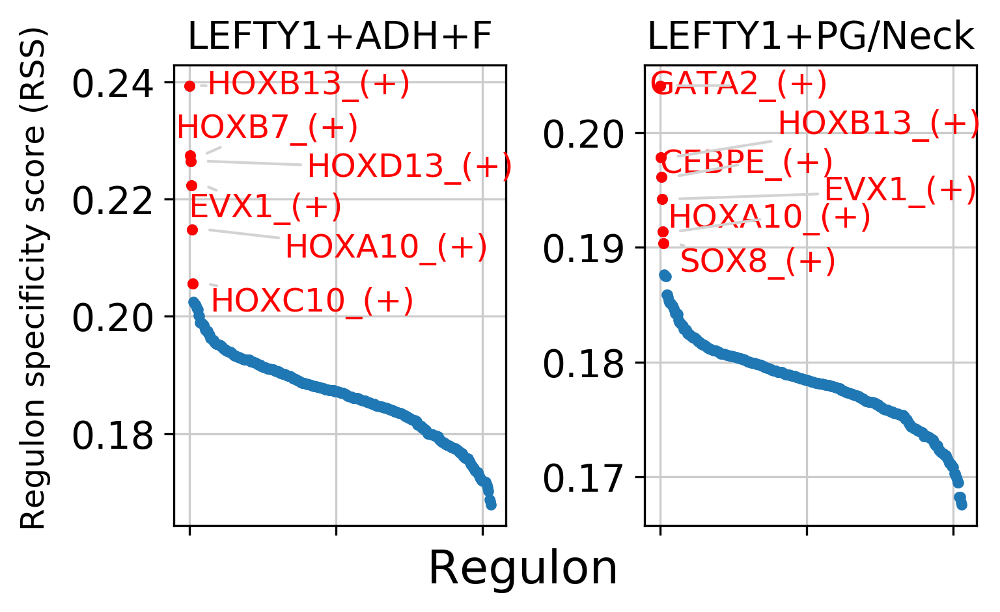

In [160]:
fig = plt.figure(figsize=(5, 3))
for c,num in zip(['LEFTY1+ADH+F','LEFTY1+PG/Neck'], range(1,len(['LEFTY1+ADH+F','LEFTY1+PG/Neck'])+1)):
    x=rss_cellType.T[c]
    ax = fig.add_subplot(1,2,num)
    plot_rss(rss_cellType, c, top_n=6, max_n=None, ax=ax)
    ax.set_ylim( x.min()-(x.max()-x.min())*0.05 , x.max()+(x.max()-x.min())*0.05 )
    for t in ax.texts:
        t.set_fontsize(12)
    ax.set_ylabel('')
    ax.set_xlabel('')
    adjust_text(ax.texts, autoalign='xy', ha='right', va='bottom', arrowprops=dict(arrowstyle='-',color='lightgrey'), precision=0.001 )
 
fig.text(0.5, 0.0, 'Regulon', ha='center', va='center', size='x-large')
fig.text(0.00, 0.5, 'Regulon specificity score (RSS)', ha='center', va='center', rotation='vertical')
plt.tight_layout()
plt.rcParams.update({
    'figure.autolayout': True,
        'figure.titlesize': 'large' ,
        'axes.labelsize': 'medium',
        'axes.titlesize':'large',
        'xtick.labelsize':'medium',
        'ytick.labelsize':'medium'
        })
#plt.savefig("PBMC10k_cellType-RSS-top5.pdf", dpi=600, bbox_inches = "tight")
plt.show()

In [106]:
cats.remove('LEFTY1+ADH+F')

In [107]:
cats.remove('LEFTY1+PG/Neck')

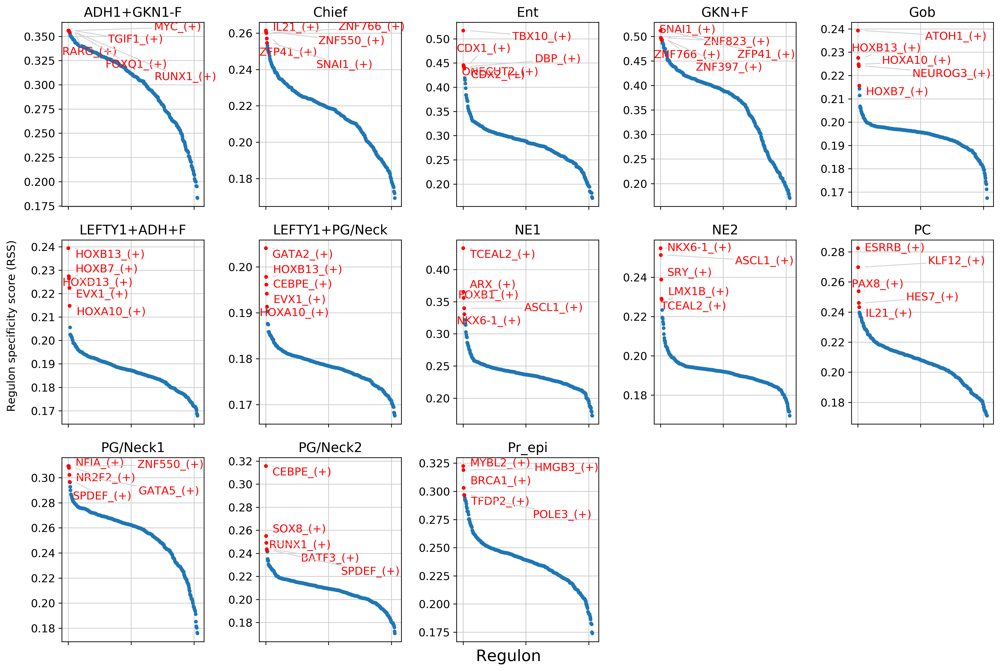

In [169]:
#cats = sorted(list(set(adata.obs['subcluster'])))

fig = plt.figure(figsize=(15, 10))
for c,num in zip(cats, range(1,len(cats)+1)):
    x=rss_cellType.T[c]
    ax = fig.add_subplot(3,5,num)
    plot_rss(rss_cellType, c, top_n=5, max_n=None, ax=ax)
    ax.set_ylim( x.min()-(x.max()-x.min())*0.05 , x.max()+(x.max()-x.min())*0.05 )
    for t in ax.texts:
        t.set_fontsize(12)
    ax.set_ylabel('')
    ax.set_xlabel('')
    adjust_text(ax.texts, autoalign='xy', ha='right', va='bottom', arrowprops=dict(arrowstyle='-',color='lightgrey'), precision=0.001 )
 
fig.text(0.5, 0.0, 'Regulon', ha='center', va='center', size='x-large')
fig.text(0.00, 0.5, 'Regulon specificity score (RSS)', ha='center', va='center', rotation='vertical')
plt.tight_layout()
plt.rcParams.update({
    'figure.autolayout': True,
        'figure.titlesize': 'large' ,
        'axes.labelsize': 'medium',
        'axes.titlesize':'large',
        'xtick.labelsize':'medium',
        'ytick.labelsize':'medium'
        })
#plt.savefig("PBMC10k_cellType-RSS-top5.pdf", dpi=600, bbox_inches = "tight")
plt.show()

cats = sorted(list(set(adata.obs['subcluster'])))

fig = plt.figure(figsize=(15, 8))
for c,num in zip(cats, range(1,len(cats)+1)):
    x=rss_cellType.T[c]
    ax = fig.add_subplot(3,5,num)
    plot_rss(rss_cellType, c, top_n=5, max_n=None, ax=ax)
    ax.set_ylim( x.min()-(x.max()-x.min())*0.05 , x.max()+(x.max()-x.min())*0.05 )
    for t in ax.texts:
        t.set_fontsize(12)
    ax.set_ylabel('')
    ax.set_xlabel('')
    adjust_text(ax.texts, autoalign='xy', ha='right', va='bottom', arrowprops=dict(arrowstyle='-',color='lightgrey'), precision=0.001 )
 
fig.text(0.5, 0.0, 'Regulon', ha='center', va='center', size='x-large')
fig.text(0.00, 0.5, 'Regulon specificity score (RSS)', ha='center', va='center', rotation='vertical', size='x-large')
plt.tight_layout()
plt.rcParams.update({
    'figure.autolayout': True,
        'figure.titlesize': 'large' ,
        'axes.labelsize': 'medium',
        'axes.titlesize':'large',
        'xtick.labelsize':'medium',
        'ytick.labelsize':'medium'
        })
plt.savefig("PBMC10k_cellType-RSS-top5.pdf", dpi=600, bbox_inches = "tight")
plt.show()

In [171]:
adata.obs['subcluster'].value_counts().sum()

26279

In [172]:
pd.DataFrame(rss_cellType).index

Index(['Chief', 'PG/Neck1', 'GKN+F', 'PG/Neck2', 'PC', 'Pr_epi', 'ADH1+GKN1-F',
       'NE2', 'NE1', 'Ent', 'Gob', 'LEFTY1+PG/Neck', 'LEFTY1+ADH+F'],
      dtype='object')

In [173]:
i=0

In [174]:
i += 1

In [175]:
top20 = pd.DataFrame()

In [176]:
for i in range(len(pd.DataFrame(rss_cellType).index)):
    top20 = pd.concat([top20,pd.DataFrame(pd.DataFrame(rss_cellType.iloc[i,:]).sort_values(pd.DataFrame(rss_cellType).index[i],ascending=False).head(20).index)],axis=1)

In [177]:
top20.columns = pd.DataFrame(rss_cellType).index

In [178]:
top20 = top20.reindex(sorted(top20.columns), axis=1)

In [179]:
top20

,ADH1+GKN1-F,Chief,Ent,GKN+F,Gob,LEFTY1+ADH+F,LEFTY1+PG/Neck,NE1,NE2,PC,PG/Neck1,PG/Neck2,Pr_epi
0,MYC_(+),IL21_(+),TBX10_(+),ZFP41_(+),ATOH1_(+),HOXB13_(+),GATA2_(+),TCEAL2_(+),NKX6-1_(+),ESRRB_(+),NFIA_(+),CEBPE_(+),MYBL2_(+)
1,TGIF1_(+),ZNF550_(+),CDX1_(+),ZNF823_(+),HOXB13_(+),HOXB7_(+),HOXB13_(+),ARX_(+),ASCL1_(+),KLF12_(+),ZNF550_(+),SOX8_(+),HMGB3_(+)
2,RARG_(+),ZNF766_(+),DBP_(+),SNAI1_(+),HOXA10_(+),HOXD13_(+),CEBPE_(+),FOXB1_(+),SRY_(+),PAX8_(+),NR2F2_(+),RUNX1_(+),BRCA1_(+)
3,FOXQ1_(+),ZFP41_(+),ONECUT2_(+),ZNF766_(+),NEUROG3_(+),EVX1_(+),EVX1_(+),ASCL1_(+),TCEAL2_(+),HES7_(+),GATA5_(+),BATF3_(+),TFDP2_(+)
4,RUNX1_(+),SNAI1_(+),CDX2_(+),ZNF397_(+),HOXB7_(+),HOXA10_(+),HOXA10_(+),NKX6-1_(+),LMX1B_(+),IL21_(+),SPDEF_(+),SPDEF_(+),POLE3_(+)
5,CEBPD_(+),ZNF135_(+),NR1I3_(+),DLX4_(+),HOXD13_(+),HOXC10_(+),SOX8_(+),PBX3_(+),ARX_(+),ZNF766_(+),FOXN3_(+),CEBPD_(+),E2F7_(+)
6,MAFF_(+),DLX4_(+),PRDM1_(+),NKX2-5_(+),BHLHE41_(+),H2AFY_(+),BATF3_(+),RFX3_(+),ZDHHC15_(+),ESRRG_(+),ZFHX3_(+),NFIA_(+),MEF2B_(+)
7,NFKB1_(+),ZNF397_(+),HOXB13_(+),ZNF135_(+),FOXP4_(+),VDR_(+),SPDEF_(+),NEUROG3_(+),NEUROG3_(+),ZFP41_(+),SOX8_(+),TFAP2C_(+),MYBL1_(+)
8,REL_(+),YY2_(+),NR1I2_(+),MEIS1_(+),HMGB3_(+),RARB_(+),NFIA_(+),SRY_(+),SOX12_(+),RFXAP_(+),ING4_(+),EGR2_(+),E2F1_(+)
9,SOX21_(+),ZNF823_(+),HOXB7_(+),FOXP3_(+),HSF1_(+),MYC_(+),MSC_(+),PAX6_(+),RFX3_(+),ZNF135_(+),CEBPD_(+),GATA5_(+),TFDP1_(+)


In [93]:
i=8
pd.DataFrame(rss_cellType.iloc[i,:]).sort_values(pd.DataFrame(rss_cellType).index[i],ascending=False).head(20)

,LEFTY1+ADH+F
ETV4(+),0.302952
CDX1(+),0.277588
HOXB13(+),0.257789
ETS2(+),0.251271
CRX(+),0.250228
GTF3C2(+),0.247520
MYC(+),0.239284
OVOL1(+),0.238410
EHF(+),0.237820
HOXB9(+),0.236804


In [101]:
topreg = []
for i,c in enumerate(cats):
    topreg.extend(
        list(rss_cellType.T[c].sort_values(ascending=False)[:5].index)
    )
topreg = list(set(topreg))

In [102]:
auc_mtx_Z = pd.DataFrame( index=auc_mtx.index )
for col in list(auc_mtx.columns):
    auc_mtx_Z[ col ] = ( auc_mtx[col] - auc_mtx[col].mean()) / auc_mtx[col].std(ddof=0)
#auc_mtx_Z.sort_index(inplace=True)

In [103]:
def palplot(pal, names, colors=None, size=1):
    n = len(pal)
    f, ax = plt.subplots(1, 1, figsize=(n * size, size))
    ax.imshow(np.arange(n).reshape(1, n),
              cmap=mpl.colors.ListedColormap(list(pal)),
              interpolation="nearest", aspect="auto")
    ax.set_xticks(np.arange(n) - .5)
    ax.set_yticks([-.5, .5])
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    colors = n * ['k'] if colors is None else colors
    for idx, (name, color) in enumerate(zip(names, colors)):
        ax.text(0.0+idx, 0.0, name, color=color, horizontalalignment='center', verticalalignment='center')
    return f

In [104]:
colors = sns.color_palette('bright',n_colors=len(cats) )
colorsd = dict( zip( cats, colors ))
colormap = [ colorsd[x] for x in adata.obs['subcluster']]

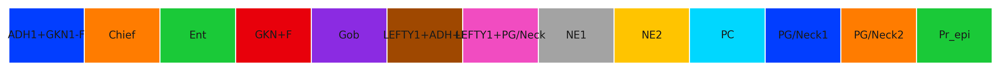

In [105]:
sns.set()
sns.set(font_scale=0.8)
fig = palplot( colors, cats, size=1.0)
#plt.savefig("PBMC10k_cellType-heatmap-legend-top5.pdf", dpi=600, bbox_inches = "tight")

In [185]:
sns.set(font_scale=1.2)
g = sns.clustermap(auc_mtx_Z[topreg], 
    yticklabels=False, xticklabels=True, vmin=-2, vmax=6, row_colors=colormap,
    cmap="YlGnBu", figsize=(21,16) )
g.cax.set_visible(True)
g.ax_heatmap.set_ylabel('')
g.ax_heatmap.set_xlabel('')
plt.savefig("PBMC10k_cellType-heatmap-top5.pdf", dpi=600, bbox_inches = "tight")

In [ ]:
binary_mtx, auc_thresholds = binarize( auc_mtx, num_workers=25 )
binary_mtx.head()

In [31]:
adjacencies = pd.read_csv("adj2.tsv", index_col=False, sep='\t')

In [32]:
1+1

2

In [34]:
from pyscenic.utils import modules_from_adjacencies
modules = list(modules_from_adjacencies(adjacencies, exprMat))


2021-07-13 10:57:53,634 - pyscenic.utils - INFO - Calculating Pearson correlations.

2021-07-13 10:57:54,913 - pyscenic.utils - WARNING - Note on correlation calculation: the default behaviour for calculating the correlations has changed after pySCENIC verion 0.9.16. Previously, the default was to calculate the correlation between a TF and target gene using only cells with non-zero expression values (mask_dropouts=True). The current default is now to use all cells to match the behavior of the R verision of SCENIC. The original settings can be retained by setting 'rho_mask_dropouts=True' in the modules_from_adjacencies function, or '--mask_dropouts' from the CLI.
	Dropout masking is currently set to [False].

2021-07-13 11:00:32,777 - pyscenic.utils - INFO - Creating modules.


In [37]:
modules.transcription_factor

AttributeError: 'list' object has no attribute 'transcription_factor'

In [41]:
tf_2 = []

In [50]:
TF_2 = adjacencies['TF'].unique()

In [52]:
'NKX6-3' in TF_2

True

In [38]:
tf = 'SOX2'
tf_mods = [ x for x in modules if x.transcription_factor==tf ]

for i,mod in enumerate( tf_mods ):
    print( f'{tf} module {str(i)}: {len(mod.genes)} genes' )
print( f'{tf} regulon: {len(regulons[tf+"_(+)"])} genes' )

SOX2 module 0: 355 genes
SOX2 module 1: 116 genes
SOX2 module 2: 51 genes
SOX2 module 3: 73 genes
SOX2 module 4: 141 genes
SOX2 module 5: 478 genes
SOX2 regulon: 18 genes


In [39]:
tf = 'HOXB13'
tf_mods = [ x for x in modules if x.transcription_factor==tf ]

for i,mod in enumerate( tf_mods ):
    print( f'{tf} module {str(i)}: {len(mod.genes)} genes' )
print( f'{tf} regulon: {len(regulons[tf+"_(+)"])} genes' )

HOXB13 module 0: 479 genes
HOXB13 module 1: 232 genes
HOXB13 module 2: 51 genes
HOXB13 module 3: 77 genes
HOXB13 module 4: 148 genes
HOXB13 module 5: 581 genes
HOXB13 regulon: 129 genes


In [481]:
tf = 'NKX6-3'
tf_mods = [ x for x in modules if x.transcription_factor==tf ]

for i,mod in enumerate( tf_mods ):
    print( f'{tf} module {str(i)}: {len(mod.genes)} genes' )
print( f'{tf} regulon: {len(regulons[tf+"_(+)"])} genes' )

NKX6-3 module 0: 351 genes
NKX6-3 module 1: 187 genes
NKX6-3 module 2: 51 genes
NKX6-3 module 3: 98 genes
NKX6-3 module 4: 182 genes
NKX6-3 module 5: 505 genes


KeyError: 'NKX6-3_(+)'

In [162]:
os.mkdir('pyscenic')

In [163]:
os.chdir('pyscenic')

In [482]:
#for i,mod in enumerate( tf_mods ):
 #   with open( tf+'_module_'+str(i)+'.txt', 'w') as f:
  #      for item in mod.genes:
   #         f.write("%s\n" % item)
            
with open( tf+'_regulon.tsv', 'w') as f:
    for item in regulons[tf+'_(+)']:
        f.write("%s\n" % item)

KeyError: 'NKX6-3_(+)'

In [481]:
tf = 'NKX6-3'
tf_mods = [ x for x in modules if x.transcription_factor==tf ]

for i,mod in enumerate( tf_mods ):
    print( f'{tf} module {str(i)}: {len(mod.genes)} genes' )
print( f'{tf} regulon: {len(regulons[tf+"_(+)"])} genes' )

NKX6-3 module 0: 351 genes
NKX6-3 module 1: 187 genes
NKX6-3 module 2: 51 genes
NKX6-3 module 3: 98 genes
NKX6-3 module 4: 182 genes
NKX6-3 module 5: 505 genes


KeyError: 'NKX6-3_(+)'

In [191]:
tf = 'TFAP4'
tf_mods = [ x for x in modules if x.transcription_factor==tf ]

for i,mod in enumerate( tf_mods ):
    print( f'{tf} module {str(i)}: {len(mod.genes)} genes' )
print( f'{tf} regulon: {len(regulons[tf+"_(+)"])} genes' )

TFAP4 module 0: 359 genes
TFAP4 module 1: 142 genes
TFAP4 module 2: 51 genes
TFAP4 module 3: 69 genes
TFAP4 module 4: 134 genes
TFAP4 module 5: 405 genes


KeyError: 'TFAP4_(+)'

In [193]:
tfap4_list = []

In [194]:
tf = 'TFAP4'
tf_mods = [ x for x in modules if x.transcription_factor==tf ]

for i,mod in enumerate( tf_mods ):
    tfap4_list.append(mod.genes)
#print( f'{tf} regulon: {len(regulons[tf+"_(+)"])} genes' )

In [207]:
s_union =  set(tfap4_list[0]) | set(tfap4_list[1]) | set(tfap4_list[2]) | set(tfap4_list[3])# & set(tfap4_list[4]) & set(tfap4_list[5])


In [205]:
s_intersection =  set(tfap4_list[0])& set(tfap4_list[1]) & set(tfap4_list[2]) & set(tfap4_list[3])# & set(tfap4_list[4]) & set(tfap4_list[5])


In [206]:
s_intersection

{'AC026774.1',
 'ARCN1',
 'ARHGAP23',
 'ATP11A',
 'CLDN10',
 'FAM122A',
 'FAM131C',
 'FXN',
 'GUCY1A1',
 'MANBA',
 'MLH1',
 'PPP2R1B',
 'RGP1',
 'RRNAD1',
 'SH3GL2',
 'SRRM4',
 'TBC1D24',
 'TFAP4',
 'TMEM178A',
 'TMOD2',
 'TUBB3',
 'USP41',
 'ZFPL1',
 'ZNF782'}

In [197]:
len(tfap4_list)

6

In [60]:
os.getcwd()

'/data/tsubosaka/integrated_data/論文用再検討/修正'

In [61]:
!mv *.tsv pyscenic

In [58]:
for tf in TF_2:
    tf_mods = [ x for x in modules if x.transcription_factor==tf ]

    try:
        with open( tf+'_regulon.tsv', 'w') as f:
            for item in regulons[tf+'_(+)']:
                f.write("%s\n" % item)
    except KeyError:
        print(tf)

LTF
UQCRB
ID1
NR2F2
HES6
PHLDA2
HMGB1
LHX5
HNRNPA1
H2AFZ
PCK2
IRX2
HMGB2
RBPJL
EDN1
EEF1D
FEV
UBB
CYCS
HSPA5
MXD1
PRDX5
SUCLG1
ETV5
ID2
P4HB
SOD1
YWHAZ
GADD45A
SLC18A1
ENO1
HTATIP2
CD59
HHEX
TPI1
NKX6-3
CKMT1B
GPD1
PROX1
FHL2
TGIF1
SRP9
NR4A1
ETFB
INSM1
RBM3
CTNNB1
EIF5A2
ISL1
UBE2V1
PKM
NPDC1
EZR
MEF2C
NAP1L1
HNRNPA0
HADHB
ARX
HCLS1
TBX3
YWHAE
RAN
NKX6-2
HIST2H2AB
MECOM
HES1
HOXB7
DUSP26
MAFB
NNT
BACH2
NKX2-2
NME1
H2AFY
CYB5R1
ZNF706
SCAND1
ANXA11
UBXN1
A1CF
POU2AF1
APEX1
DR1
HIST2H2BE
ANXA1
PSMA6
CEBPD
FOXM1
GOT1
CAT
GTF2A2
ZNF146
BAX
CANX
NFIB
HNRNPC
ZKSCAN1
CHURC1
SFPQ
ZNF296
TIA1
SNRNP70
TCEAL6
PAX8
ACAA1
ZNF391
TBX10
ZNF22
NFIA
ARID5B
DNMT1
NEUROG3
SPAG7
LRRFIP1
AKR1A1
MRPS25
NR4A3
SFT2D1
SMUG1
ZMAT4
UTP18
CSNK2B
RNF114
CERS4
ZNF331
NUCB1
MIEF1
ILF2
ZNF564
ZNF771
MELK
MXD3
ARID5A
NR0B1
PRDM12
BAD
TPPP
ZSCAN16
ZBTB45
ZBTB20
TRIM21
INSM2
NHLH2
NCBP2
ZNF486
ZNF34
HOXA5
DTL
SNRPB2
MEIS2
KDM2A
ZNF460
HDAC1
BCL11A
ZNF774
ZNF66
GTF2I
RORC
ZSCAN26
POLD2
RBM42
RBM8A
ZBTB43
NR1D2
PLAGL1
ZF

In [164]:
adata.obs.subcluster.dtype.categories

Index(['ADH1+GKN1-F', 'Chief', 'Ent', 'GKN+F', 'Gob', 'LEFTY1+ADH+F',
       'LEFTY1+PG/Neck', 'NE1', 'NE2', 'PC', 'PG/Neck1', 'PG/Neck2', 'Pr_epi'],
      dtype='object')

In [165]:
N_COLORS = len(adata.obs.subcluster.dtype.categories)
COLORS = [color['color'] for color in mpl.rcParams["axes.prop_cycle"]]

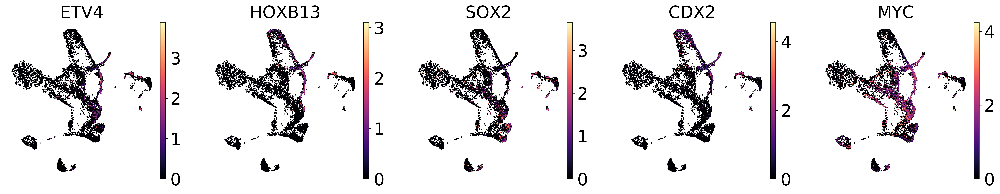

In [170]:
sc.set_figure_params(frameon=False, dpi=300, fontsize=24)
sc.pl.umap(adata, color=[ 'ETV4', 'HOXB13', 'SOX2','CDX2','MYC'],
           title=[ 'ETV4', 'HOXB13','SOX2', 'CDX2', 'MYC'], ncols=5, use_raw=False,
         palette=COLORS, cmap='magma')

In [175]:
rss_cellType

,ADNP2(+),AHR(+),AR(+),ARNT(+),ARNT2(+),ARNTL2(+),ASCL1(+),ATF1(+),ATF2(+),ATF3(+),...,ZNF778(+),ZNF780A(+),ZNF789(+),ZNF799(+),ZNF813(+),ZNF831(+),ZNF841(+),ZNF853(+),ZNF90(+),ZNF93(+)
PG/Neck2,0.273263,0.273027,0.254471,0.275039,0.219285,0.292824,0.241847,0.274288,0.275043,0.297226,...,0.249986,0.195533,0.243097,0.252131,0.224665,0.212598,0.262422,0.215849,0.215682,0.204419
PC,0.195147,0.220560,0.254935,0.215807,0.267868,0.240928,0.246108,0.258914,0.256663,0.234656,...,0.209197,0.219194,0.287320,0.292398,0.270807,0.189227,0.207010,0.179655,0.200098,0.196871
Chief,0.211415,0.228002,0.306557,0.241292,0.283055,0.247779,0.251680,0.257563,0.266696,0.246695,...,0.216736,0.174606,0.292535,0.293342,0.279682,0.195434,0.227430,0.192027,0.200989,0.207189
ADH1+GKN1-F,0.273116,0.304857,0.250767,0.270878,0.226876,0.299046,0.223888,0.273218,0.273516,0.288698,...,0.252225,0.178400,0.247443,0.234087,0.239651,0.210874,0.234404,0.205782,0.216537,0.213571
PG/Neck1,0.228098,0.255661,0.278047,0.260967,0.261397,0.263994,0.249081,0.265848,0.272337,0.262964,...,0.233643,0.179322,0.286611,0.274325,0.262589,0.206367,0.266268,0.197647,0.200394,0.205186
NE2,0.209822,0.220009,0.224903,0.247524,0.257310,0.224911,0.323839,0.236796,0.242331,0.230402,...,0.219261,0.198115,0.225901,0.232834,0.219157,0.206719,0.203060,0.203504,0.188646,0.189032
NE1,0.236897,0.258651,0.257259,0.262379,0.291122,0.253133,0.356343,0.265999,0.279886,0.263849,...,0.244748,0.192533,0.247105,0.257782,0.234487,0.212474,0.221487,0.219113,0.202480,0.200028
Pr_epi,0.232920,0.252893,0.245027,0.227005,0.249173,0.270759,0.221969,0.267924,0.264209,0.257309,...,0.240361,0.176100,0.243510,0.249590,0.246259,0.215487,0.197430,0.193299,0.210478,0.220263
LEFTY1+ADH+F,0.218783,0.218842,0.210866,0.201418,0.185121,0.217708,0.182207,0.210921,0.208778,0.225453,...,0.211067,0.169409,0.187282,0.180951,0.189029,0.192508,0.186507,0.215722,0.215961,0.191693
GKN+F,0.219534,0.273769,0.280325,0.228161,0.280586,0.262399,0.255773,0.257850,0.264031,0.260486,...,0.216153,0.187563,0.288383,0.294869,0.281310,0.190836,0.212587,0.180377,0.186795,0.186608


In [173]:
df_scores

,Regulon(ADNP2(+)),Regulon(AHR(+)),Regulon(AR(+)),Regulon(ARNT(+)),Regulon(ARNT2(+)),Regulon(ARNTL2(+)),Regulon(ASCL1(+)),Regulon(ATF1(+)),Regulon(ATF2(+)),Regulon(ATF3(+)),...,Regulon(ZNF780A(+)),Regulon(ZNF789(+)),Regulon(ZNF799(+)),Regulon(ZNF813(+)),Regulon(ZNF831(+)),Regulon(ZNF841(+)),Regulon(ZNF853(+)),Regulon(ZNF90(+)),Regulon(ZNF93(+)),subcluster
Stanford_5846N1-total_AACTCCCAGCATCATC,0.000000,0.055923,0.327768,0.029959,0.026983,0.085583,0.000000,0.063220,0.044795,0.159820,...,0.000000,0.033207,0.000000,0.000000,0.000000,0.170021,0.000000,0.000000,0.0,PG/Neck2
Stanford_5846N1-total_AACTGGTCAGCTGTAT,0.170443,0.092077,0.000000,0.035202,0.000000,0.111024,0.009853,0.126512,0.072804,0.152079,...,0.000000,0.128578,0.100626,0.038760,0.000000,0.000000,0.000000,0.000000,0.0,PC
Stanford_5846N1-total_ACGCCAGAGCCACCTG,0.101073,0.062353,0.331346,0.000000,0.000000,0.131309,0.065792,0.060095,0.088950,0.136912,...,0.129756,0.070289,0.019231,0.000000,0.050686,0.000000,0.000000,0.000000,0.0,Chief
Stanford_5846N1-total_ACTGAACCAGTTAACC,0.000000,0.081434,0.153449,0.000000,0.052773,0.084212,0.064287,0.055730,0.056064,0.109184,...,0.000000,0.041108,0.133870,0.019593,0.000000,0.000000,0.000000,0.000000,0.0,PC
Stanford_5846N1-total_ACTGAGTCACCATGTA,0.000000,0.118107,0.167362,0.000000,0.008646,0.108956,0.008973,0.026476,0.057375,0.125864,...,0.000000,0.052326,0.044723,0.068277,0.000000,0.000000,0.000000,0.111628,0.0,ADH1+GKN1-F
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Tsinghua_12320058M-total_TTTCCTCGTGTGGTTT,0.131783,0.049195,0.016100,0.000000,0.118962,0.062668,0.106625,0.057555,0.057404,0.079850,...,0.000000,0.047965,0.037120,0.056010,0.000000,0.000000,0.000000,0.000000,0.0,NE1
Tsinghua_12320058M-total_TTTGCGCGTGTTGGGA,0.000000,0.053369,0.417810,0.000000,0.037045,0.045999,0.019877,0.044043,0.045388,0.109255,...,0.000000,0.065370,0.189475,0.010648,0.000000,0.097421,0.000000,0.000000,0.0,GKN+F
Tsinghua_12320058M-total_TTTGGTTTCCGAAGAG,0.131584,0.150320,0.072948,0.052598,0.022585,0.092003,0.014482,0.065868,0.050735,0.145704,...,0.000000,0.053965,0.073196,0.002470,0.000000,0.000000,0.217501,0.000000,0.0,GKN+F
Tsinghua_12320058M-total_TTTGTCAGTGGTAACG,0.289704,0.058191,0.170344,0.000000,0.059183,0.067104,0.028395,0.075957,0.064681,0.085667,...,0.000000,0.047443,0.262895,0.023256,0.000000,0.000000,0.000000,0.181992,0.0,PG/Neck1


In [179]:
df_scores.groupby(by='subcluster').mean()

,Regulon(ADNP2(+)),Regulon(AHR(+)),Regulon(AR(+)),Regulon(ARNT(+)),Regulon(ARNT2(+)),Regulon(ARNTL2(+)),Regulon(ASCL1(+)),Regulon(ATF1(+)),Regulon(ATF2(+)),Regulon(ATF3(+)),...,Regulon(ZNF778(+)),Regulon(ZNF780A(+)),Regulon(ZNF789(+)),Regulon(ZNF799(+)),Regulon(ZNF813(+)),Regulon(ZNF831(+)),Regulon(ZNF841(+)),Regulon(ZNF853(+)),Regulon(ZNF90(+)),Regulon(ZNF93(+))
subcluster,,,,,,,,,,,,,,,,,,,,,
ADH1+GKN1-F,0.067143,0.111754,0.206120,0.027961,0.031422,0.088344,0.022380,0.053793,0.055245,0.137349,...,0.026625,0.002505,0.034298,0.064891,0.018481,0.013962,0.021534,0.010445,0.025249,0.007313
Chief,0.029181,0.041643,0.362817,0.020827,0.060227,0.047339,0.033680,0.043891,0.050862,0.079939,...,0.016568,0.001788,0.053921,0.134911,0.026501,0.010314,0.022677,0.008504,0.018394,0.005389
Ent,0.049905,0.101904,0.149775,0.025854,0.025528,0.060554,0.018185,0.052275,0.047995,0.125603,...,0.019347,0.013159,0.026332,0.070568,0.016794,0.009189,0.010949,0.008500,0.132343,0.003585
GKN+F,0.035040,0.082611,0.279339,0.016561,0.055570,0.058438,0.035102,0.043990,0.048861,0.097566,...,0.017391,0.005096,0.050785,0.131826,0.025914,0.009484,0.017066,0.004605,0.011648,0.003142
Gob,0.068886,0.079302,0.214996,0.022357,0.043446,0.058961,0.035700,0.050607,0.049957,0.115182,...,0.022785,0.002565,0.032180,0.085683,0.019144,0.016148,0.023383,0.009191,0.036083,0.004033
LEFTY1+ADH+F,0.068467,0.087955,0.239155,0.018713,0.020021,0.072146,0.012571,0.048975,0.047509,0.150825,...,0.026855,0.000630,0.017224,0.027672,0.011466,0.012784,0.011454,0.022903,0.049302,0.005971
LEFTY1+PG/Neck,0.061720,0.075745,0.194798,0.024317,0.024530,0.077130,0.030741,0.045494,0.049246,0.161210,...,0.025566,0.000441,0.020296,0.053347,0.015512,0.009726,0.017150,0.028972,0.043682,0.007328
NE1,0.044796,0.066532,0.219998,0.026146,0.072285,0.050514,0.098439,0.049289,0.059741,0.101983,...,0.025689,0.005339,0.032688,0.091981,0.015557,0.015907,0.018281,0.015872,0.018218,0.005583
NE2,0.039024,0.056263,0.206274,0.034438,0.076660,0.051355,0.130457,0.053455,0.060028,0.100506,...,0.024533,0.008110,0.035834,0.100317,0.017965,0.017997,0.017121,0.016264,0.015661,0.004681


In [180]:
df_obs[signature_column_names].mean()

Regulon(ADNP2(+))     0.045902
Regulon(AHR(+))       0.072341
Regulon(AR(+))        0.230873
Regulon(ARNT(+))      0.022920
Regulon(ARNT2(+))     0.046320
                        ...   
Regulon(ZNF831(+))    0.012873
Regulon(ZNF841(+))    0.019827
Regulon(ZNF853(+))    0.010284
Regulon(ZNF90(+))     0.032079
Regulon(ZNF93(+))     0.005385
Length: 429, dtype: float64

In [185]:
((df_scores.groupby(by='subcluster').mean() - df_obs[signature_column_names].mean())/ df_obs[signature_column_names].std()).stack().reset_index()

,subcluster,level_1,0
0,ADH1+GKN1-F,Regulon(ADNP2(+)),0.304987
1,ADH1+GKN1-F,Regulon(AHR(+)),0.824023
2,ADH1+GKN1-F,Regulon(AR(+)),-0.150670
3,ADH1+GKN1-F,Regulon(ARNT(+)),0.203022
4,ADH1+GKN1-F,Regulon(ARNT2(+)),-0.316869
...,...,...,...
5572,Pr_epi,Regulon(ZNF831(+)),0.088429
5573,Pr_epi,Regulon(ZNF841(+)),-0.239939
5574,Pr_epi,Regulon(ZNF853(+)),-0.072095
5575,Pr_epi,Regulon(ZNF90(+)),-0.137318


In [190]:
auc_mtx

,ADNP2(+),AHR(+),AR(+),ARNT(+),ARNT2(+),ARNTL2(+),ASCL1(+),ATF1(+),ATF2(+),ATF3(+),...,ZNF778(+),ZNF780A(+),ZNF789(+),ZNF799(+),ZNF813(+),ZNF831(+),ZNF841(+),ZNF853(+),ZNF90(+),ZNF93(+)
Stanford_5846N1-total_AACTCCCAGCATCATC,0.000000,0.055923,0.327768,0.029959,0.026983,0.085583,0.000000,0.063220,0.044795,0.159820,...,0.000000,0.000000,0.033207,0.000000,0.000000,0.000000,0.170021,0.000000,0.000000,0.0
Stanford_5846N1-total_AACTGGTCAGCTGTAT,0.170443,0.092077,0.000000,0.035202,0.000000,0.111024,0.009853,0.126512,0.072804,0.152079,...,0.060552,0.000000,0.128578,0.100626,0.038760,0.000000,0.000000,0.000000,0.000000,0.0
Stanford_5846N1-total_ACGCCAGAGCCACCTG,0.101073,0.062353,0.331346,0.000000,0.000000,0.131309,0.065792,0.060095,0.088950,0.136912,...,0.053559,0.129756,0.070289,0.019231,0.000000,0.050686,0.000000,0.000000,0.000000,0.0
Stanford_5846N1-total_ACTGAACCAGTTAACC,0.000000,0.081434,0.153449,0.000000,0.052773,0.084212,0.064287,0.055730,0.056064,0.109184,...,0.069496,0.000000,0.041108,0.133870,0.019593,0.000000,0.000000,0.000000,0.000000,0.0
Stanford_5846N1-total_ACTGAGTCACCATGTA,0.000000,0.118107,0.167362,0.000000,0.008646,0.108956,0.008973,0.026476,0.057375,0.125864,...,0.154063,0.000000,0.052326,0.044723,0.068277,0.000000,0.000000,0.000000,0.111628,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Tsinghua_12320058M-total_TTTCCTCGTGTGGTTT,0.131783,0.049195,0.016100,0.000000,0.118962,0.062668,0.106625,0.057555,0.057404,0.079850,...,0.000000,0.000000,0.047965,0.037120,0.056010,0.000000,0.000000,0.000000,0.000000,0.0
Tsinghua_12320058M-total_TTTGCGCGTGTTGGGA,0.000000,0.053369,0.417810,0.000000,0.037045,0.045999,0.019877,0.044043,0.045388,0.109255,...,0.000000,0.000000,0.065370,0.189475,0.010648,0.000000,0.097421,0.000000,0.000000,0.0
Tsinghua_12320058M-total_TTTGGTTTCCGAAGAG,0.131584,0.150320,0.072948,0.052598,0.022585,0.092003,0.014482,0.065868,0.050735,0.145704,...,0.066894,0.000000,0.053965,0.073196,0.002470,0.000000,0.000000,0.217501,0.000000,0.0
Tsinghua_12320058M-total_TTTGTCAGTGGTAACG,0.289704,0.058191,0.170344,0.000000,0.059183,0.067104,0.028395,0.075957,0.064681,0.085667,...,0.000000,0.000000,0.047443,0.262895,0.023256,0.000000,0.000000,0.000000,0.181992,0.0


In [191]:
df_scores

,Regulon(ADNP2(+)),Regulon(AHR(+)),Regulon(AR(+)),Regulon(ARNT(+)),Regulon(ARNT2(+)),Regulon(ARNTL2(+)),Regulon(ASCL1(+)),Regulon(ATF1(+)),Regulon(ATF2(+)),Regulon(ATF3(+)),...,Regulon(ZNF780A(+)),Regulon(ZNF789(+)),Regulon(ZNF799(+)),Regulon(ZNF813(+)),Regulon(ZNF831(+)),Regulon(ZNF841(+)),Regulon(ZNF853(+)),Regulon(ZNF90(+)),Regulon(ZNF93(+)),subcluster
Stanford_5846N1-total_AACTCCCAGCATCATC,0.000000,0.055923,0.327768,0.029959,0.026983,0.085583,0.000000,0.063220,0.044795,0.159820,...,0.000000,0.033207,0.000000,0.000000,0.000000,0.170021,0.000000,0.000000,0.0,PG/Neck2
Stanford_5846N1-total_AACTGGTCAGCTGTAT,0.170443,0.092077,0.000000,0.035202,0.000000,0.111024,0.009853,0.126512,0.072804,0.152079,...,0.000000,0.128578,0.100626,0.038760,0.000000,0.000000,0.000000,0.000000,0.0,PC
Stanford_5846N1-total_ACGCCAGAGCCACCTG,0.101073,0.062353,0.331346,0.000000,0.000000,0.131309,0.065792,0.060095,0.088950,0.136912,...,0.129756,0.070289,0.019231,0.000000,0.050686,0.000000,0.000000,0.000000,0.0,Chief
Stanford_5846N1-total_ACTGAACCAGTTAACC,0.000000,0.081434,0.153449,0.000000,0.052773,0.084212,0.064287,0.055730,0.056064,0.109184,...,0.000000,0.041108,0.133870,0.019593,0.000000,0.000000,0.000000,0.000000,0.0,PC
Stanford_5846N1-total_ACTGAGTCACCATGTA,0.000000,0.118107,0.167362,0.000000,0.008646,0.108956,0.008973,0.026476,0.057375,0.125864,...,0.000000,0.052326,0.044723,0.068277,0.000000,0.000000,0.000000,0.111628,0.0,ADH1+GKN1-F
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Tsinghua_12320058M-total_TTTCCTCGTGTGGTTT,0.131783,0.049195,0.016100,0.000000,0.118962,0.062668,0.106625,0.057555,0.057404,0.079850,...,0.000000,0.047965,0.037120,0.056010,0.000000,0.000000,0.000000,0.000000,0.0,NE1
Tsinghua_12320058M-total_TTTGCGCGTGTTGGGA,0.000000,0.053369,0.417810,0.000000,0.037045,0.045999,0.019877,0.044043,0.045388,0.109255,...,0.000000,0.065370,0.189475,0.010648,0.000000,0.097421,0.000000,0.000000,0.0,GKN+F
Tsinghua_12320058M-total_TTTGGTTTCCGAAGAG,0.131584,0.150320,0.072948,0.052598,0.022585,0.092003,0.014482,0.065868,0.050735,0.145704,...,0.000000,0.053965,0.073196,0.002470,0.000000,0.000000,0.217501,0.000000,0.0,GKN+F
Tsinghua_12320058M-total_TTTGTCAGTGGTAACG,0.289704,0.058191,0.170344,0.000000,0.059183,0.067104,0.028395,0.075957,0.064681,0.085667,...,0.000000,0.047443,0.262895,0.023256,0.000000,0.000000,0.000000,0.181992,0.0,PG/Neck1


In [172]:
df_obs = adata.obs
signature_column_names = list(df_obs.select_dtypes('number').columns)
signature_column_names = list(filter(lambda s: s.startswith('Regulon('), signature_column_names))
df_scores = df_obs[signature_column_names + ['subcluster']] # auc_mtxと同一
df_results = ((df_scores.groupby(by='subcluster').mean() - df_obs[signature_column_names].mean())/ df_obs[signature_column_names].std()).stack().reset_index().rename(columns={'level_1': 'regulon', 0:'Z'})
df_results['regulon'] = list(map(lambda s: s[8:-1], df_results.regulon))
df_results[(df_results.Z >=2)].sort_values('Z', ascending=False).head()

,subcluster,regulon,Z
2663,LEFTY1+PG/Neck,ETV4(+),2.427438
1731,Gob,ATOH1(+),2.264056
1087,Ent,NR1I2(+),2.252685
1086,Ent,NR1H4(+),2.247457
2293,LEFTY1+ADH+F,HOXB13(+),2.212993


In [186]:
regulon_Z1 = df_results[(df_results.Z >=2)]['regulon']

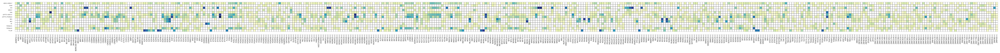

In [111]:
df_heatmap = pd.pivot_table(data=df_results[df_results.Z >= 0].sort_values('Z', ascending=False),
                           index='subcluster', columns='regulon', values='Z')
#df_heatmap.drop(index='Myocyte', inplace=True) # We leave out Myocyte because many TFs are highly enriched (becuase of small number of cells).
with plt.style.context({
                        'xtick.labelsize':6,
                        'ytick.labelsize':4}):
    fig, ax1 = plt.subplots(1, 1, figsize=(48, 40))
    sns.heatmap(df_heatmap, ax=ax1, annot=True, fmt=".1f", linewidths=.7, cbar=False, square=True, linecolor='gray', 
            cmap="YlGnBu", annot_kws={"size":0})
    ax1.set_xlabel('',fontsize=8)
    ax1.set_ylabel('',fontsize=8)

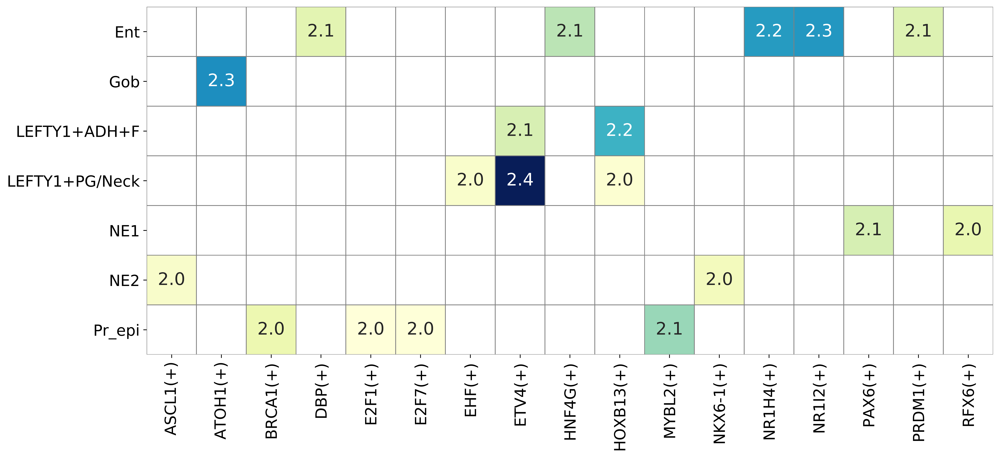

In [195]:
df_heatmap = pd.pivot_table(data=df_results[df_results.Z >= 1.98].sort_values('Z', ascending=False),
                           index='subcluster', columns='regulon', values='Z')
#df_heatmap.drop(index='Myocyte', inplace=True) # We leave out Myocyte because many TFs are highly enriched (becuase of small number of cells).
with plt.style.context({
                        'xtick.labelsize':16,
                        'ytick.labelsize':16}):
    fig, ax1 = plt.subplots(1, 1, figsize=(15, 8))
    sns.heatmap(df_heatmap, ax=ax1, annot=True, fmt=".1f", linewidths=.7, cbar=False, square=True, linecolor='gray', 
            cmap="YlGnBu", annot_kws={"size":18})
    ax1.set_xlabel('',fontsize=30)
    ax1.set_ylabel('',fontsize=30)

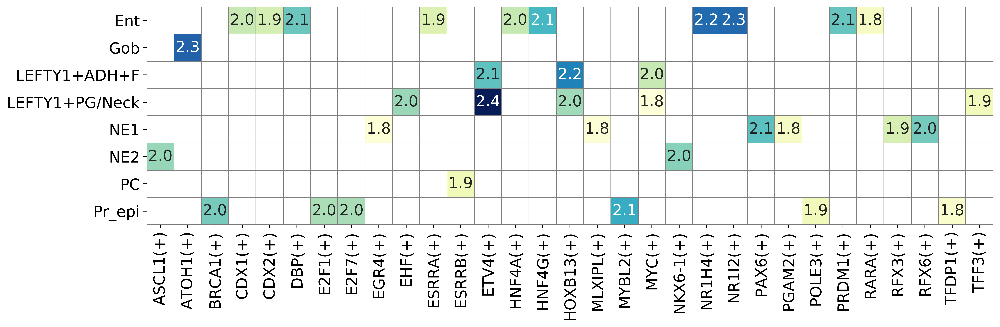

In [197]:
df_heatmap = pd.pivot_table(data=df_results[df_results.Z >= 1.78].sort_values('Z', ascending=False),
                           index='subcluster', columns='regulon', values='Z')
#df_heatmap.drop(index='Myocyte', inplace=True) # We leave out Myocyte because many TFs are highly enriched (becuase of small number of cells).
with plt.style.context({
                        'xtick.labelsize':16,
                        'ytick.labelsize':16}):
    fig, ax1 = plt.subplots(1, 1, figsize=(15, 8))
    sns.heatmap(df_heatmap, ax=ax1, annot=True, fmt=".1f", linewidths=.7, cbar=False, square=True, linecolor='gray', 
            cmap="YlGnBu", annot_kws={"size":16})
    ax1.set_xlabel('',fontsize=30)
    ax1.set_ylabel('',fontsize=30)

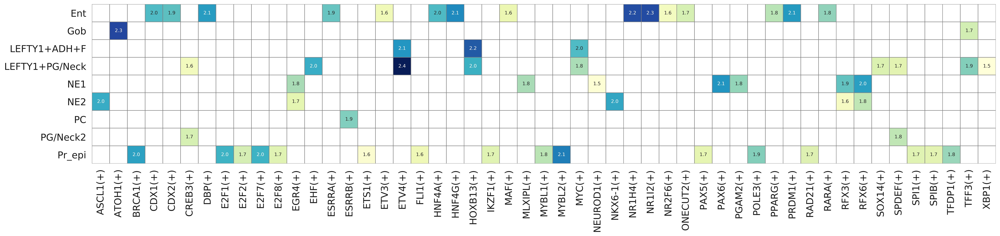

In [332]:
df_heatmap = pd.pivot_table(data=df_results[df_results.Z >= 1.5].sort_values('Z', ascending=False),
                           index='subcluster', columns='regulon', values='Z')
#df_heatmap.drop(index='Myocyte', inplace=True) # We leave out Myocyte because many TFs are highly enriched (becuase of small number of cells).
with plt.style.context({
                        'xtick.labelsize':16,
                        'ytick.labelsize':16}):
    fig, ax1 = plt.subplots(1, 1, figsize=(24, 16))
    sns.heatmap(df_heatmap, ax=ax1, annot=True, fmt=".1f", linewidths=.7, cbar=False, square=True, linecolor='gray', 
            cmap="YlGnBu", annot_kws={"size":8})
    ax1.set_xlabel('',fontsize=30)
    ax1.set_ylabel('',fontsize=30)

In [535]:
df_heatmap = pd.pivot_table(data=df_results[df_results.Z >= 2].sort_values('Z', ascending=False),
                           index='subcluster', columns='regulon', values='Z')
#df_heatmap.drop(index='Myocyte', inplace=True) # We leave out Myocyte because many TFs are highly enriched (becuase of small number of cells).
with plt.style.context({
                        'xtick.labelsize':16,
                        'ytick.labelsize':16}):
    fig, ax1 = plt.subplots(1, 1, figsize=(24, 16))
    sns.heatmap(df_heatmap, ax=ax1, annot=True, fmt=".1f", linewidths=.7, cbar=False, square=True, linecolor='gray', 
            cmap="YlGnBu", annot_kws={"size":8})
    ax1.set_xlabel('',fontsize=30)
    ax1.set_ylabel('',fontsize=30)

In [262]:
!pwd

/data/tsubosaka/integrated_data/論文用再検討/修正/pyscenic


In [263]:
!rm *.txt

In [113]:
!cd pyscenic/

In [115]:
os.getcwd()

'/data/tsubosaka/integrated_data/論文用再検討/修正'

In [266]:
os.listdir('./')[0:5]

['BCL3_regulon.tsv',
 'ZNF316_regulon.tsv',
 'NCOR2_regulon.tsv',
 'PPARG_regulon.tsv',
 'PRDM1_regulon.tsv']

In [507]:
Ent_regulon = df_results[(df_results.Z >=1)&((df_results.subcluster=='LEFTY1+ADH+F')|(df_results.subcluster=='LEFTY1+PG/Neck'))]

In [509]:
Ent_regulon['regulon']

2154       ATF3(+)
2175       CDX1(+)
2209       EGR1(+)
2213        EHF(+)
2224        ERF(+)
2231       ETS2(+)
2234       ETV4(+)
2240      FOSL1(+)
2269      HDAC2(+)
2280      HMGA1(+)
2293     HOXB13(+)
2302       HSF1(+)
2318       JUND(+)
2327       KLF3(+)
2328       KLF4(+)
2329       KLF5(+)
2330       KLF6(+)
2350        MYC(+)
2372      NR1H3(+)
2388      OVOL1(+)
2401      POLE4(+)
2463        SP2(+)
2499       TFF3(+)
2509       YBX1(+)
2526     ZNF165(+)
2583       ATF3(+)
2584       ATF4(+)
2613      CREB3(+)
2614    CREB3L1(+)
2618       CREM(+)
2638       EGR1(+)
2640       EGR3(+)
2642        EHF(+)
2644       ELF3(+)
2663       ETV4(+)
2667        FOS(+)
2668       FOSB(+)
2698      HDAC2(+)
2709      HMGA1(+)
2719      HOXA6(+)
2722     HOXB13(+)
2723      HOXB2(+)
2734       IRF1(+)
2745        JUN(+)
2746       JUNB(+)
2747       JUND(+)
2749      KLF10(+)
2759       KLF6(+)
2764       MAFF(+)
2779        MYC(+)
2801      NR1H3(+)
2881      SOX14(+)
2886       S

ls = [x for x in os.listdir() if x.endswith('tsv')]

ls.remove('adj2.tsv')

In [513]:
ls = []
for item in Ent_regulon['regulon']:
    ls.append(item.split('(')[0]+'_regulon.tsv')

In [514]:
ls

['ATF3_regulon.tsv',
 'CDX1_regulon.tsv',
 'EGR1_regulon.tsv',
 'EHF_regulon.tsv',
 'ERF_regulon.tsv',
 'ETS2_regulon.tsv',
 'ETV4_regulon.tsv',
 'FOSL1_regulon.tsv',
 'HDAC2_regulon.tsv',
 'HMGA1_regulon.tsv',
 'HOXB13_regulon.tsv',
 'HSF1_regulon.tsv',
 'JUND_regulon.tsv',
 'KLF3_regulon.tsv',
 'KLF4_regulon.tsv',
 'KLF5_regulon.tsv',
 'KLF6_regulon.tsv',
 'MYC_regulon.tsv',
 'NR1H3_regulon.tsv',
 'OVOL1_regulon.tsv',
 'POLE4_regulon.tsv',
 'SP2_regulon.tsv',
 'TFF3_regulon.tsv',
 'YBX1_regulon.tsv',
 'ZNF165_regulon.tsv',
 'ATF3_regulon.tsv',
 'ATF4_regulon.tsv',
 'CREB3_regulon.tsv',
 'CREB3L1_regulon.tsv',
 'CREM_regulon.tsv',
 'EGR1_regulon.tsv',
 'EGR3_regulon.tsv',
 'EHF_regulon.tsv',
 'ELF3_regulon.tsv',
 'ETV4_regulon.tsv',
 'FOS_regulon.tsv',
 'FOSB_regulon.tsv',
 'HDAC2_regulon.tsv',
 'HMGA1_regulon.tsv',
 'HOXA6_regulon.tsv',
 'HOXB13_regulon.tsv',
 'HOXB2_regulon.tsv',
 'IRF1_regulon.tsv',
 'JUN_regulon.tsv',
 'JUNB_regulon.tsv',
 'JUND_regulon.tsv',
 'KLF10_regulon.tsv',

ls.append('OVOL1_regulon.tsv')

ls.append('CDX2_regulon.tsv')

ls.append('SOX2_regulon.tsv')

ls.append('HOXB13_regulon.tsv')

In [515]:
len(ls)

59

In [493]:
ls

['CDX1_regulon.tsv',
 'CDX2_regulon.tsv',
 'DBP_regulon.tsv',
 'ESRRA_regulon.tsv',
 'ETV3_regulon.tsv',
 'FOSL1_regulon.tsv',
 'HNF4A_regulon.tsv',
 'HNF4G_regulon.tsv',
 'HOXB9_regulon.tsv',
 'KLF3_regulon.tsv',
 'MAF_regulon.tsv',
 'MAX_regulon.tsv',
 'NR1H4_regulon.tsv',
 'NR1I2_regulon.tsv',
 'NR2F6_regulon.tsv',
 'ONECUT2_regulon.tsv',
 'PPARA_regulon.tsv',
 'PPARD_regulon.tsv',
 'PPARG_regulon.tsv',
 'PRDM1_regulon.tsv',
 'RARA_regulon.tsv',
 'RXRA_regulon.tsv',
 'SREBF1_regulon.tsv',
 'TCF7L2_regulon.tsv',
 'VDR_regulon.tsv',
 'ZBTB7B_regulon.tsv',
 'ZNF90_regulon.tsv']

In [494]:
len(set(ls))

27

In [516]:
df = pd.DataFrame({'target':[0],'source':[0]})

In [517]:
def get_size(path='.'):
    if os.path.isfile(path):
        return os.path.getsize(path)

In [518]:
ls

['ATF3_regulon.tsv',
 'CDX1_regulon.tsv',
 'EGR1_regulon.tsv',
 'EHF_regulon.tsv',
 'ERF_regulon.tsv',
 'ETS2_regulon.tsv',
 'ETV4_regulon.tsv',
 'FOSL1_regulon.tsv',
 'HDAC2_regulon.tsv',
 'HMGA1_regulon.tsv',
 'HOXB13_regulon.tsv',
 'HSF1_regulon.tsv',
 'JUND_regulon.tsv',
 'KLF3_regulon.tsv',
 'KLF4_regulon.tsv',
 'KLF5_regulon.tsv',
 'KLF6_regulon.tsv',
 'MYC_regulon.tsv',
 'NR1H3_regulon.tsv',
 'OVOL1_regulon.tsv',
 'POLE4_regulon.tsv',
 'SP2_regulon.tsv',
 'TFF3_regulon.tsv',
 'YBX1_regulon.tsv',
 'ZNF165_regulon.tsv',
 'ATF3_regulon.tsv',
 'ATF4_regulon.tsv',
 'CREB3_regulon.tsv',
 'CREB3L1_regulon.tsv',
 'CREM_regulon.tsv',
 'EGR1_regulon.tsv',
 'EGR3_regulon.tsv',
 'EHF_regulon.tsv',
 'ELF3_regulon.tsv',
 'ETV4_regulon.tsv',
 'FOS_regulon.tsv',
 'FOSB_regulon.tsv',
 'HDAC2_regulon.tsv',
 'HMGA1_regulon.tsv',
 'HOXA6_regulon.tsv',
 'HOXB13_regulon.tsv',
 'HOXB2_regulon.tsv',
 'IRF1_regulon.tsv',
 'JUN_regulon.tsv',
 'JUNB_regulon.tsv',
 'JUND_regulon.tsv',
 'KLF10_regulon.tsv',

In [519]:
df = pd.DataFrame({'target':[0],'source':[0]})

In [520]:
for item in ls:
    reg1 = pd.read_table(item,header=None)
    reg1.columns = ['target']
    reg1['source'] = item.split('_')[0]
    df = pd.concat([df,reg1],axis=0)


In [521]:
df = df.iloc[1:,:]

In [522]:
df

,target,source
0,RNF223,ATF3
1,AURKAIP1,ATF3
2,ERRFI1,ATF3
3,AGTRAP,ATF3
4,MTHFR,ATF3
...,...,...
90,C2CD2,ZNF165
0,GSTM3,ZNF416
1,TMEM45A,ZNF416
2,PRR5L,ZNF416


In [502]:
df['source'].unique()

array(['CDX1', 'CDX2', 'DBP', 'ESRRA', 'ETV3', 'FOSL1', 'HNF4A', 'HNF4G',
       'HOXB9', 'KLF3', 'MAF', 'MAX', 'NR1H4', 'NR1I2', 'NR2F6',
       'ONECUT2', 'PPARA', 'PPARD', 'PPARG', 'PRDM1', 'RARA', 'RXRA',
       'SREBF1', 'TCF7L2', 'VDR', 'ZBTB7B', 'ZNF90'], dtype=object)

In [503]:
!pwd

/data/tsubosaka/integrated_data/論文用再検討/修正/pyscenic


In [504]:
len(df['source'].unique())

27

In [505]:
len(df['source'].unique())

27

In [523]:
df.to_csv('./LEFTY/summary_Z1.csv')

In [440]:
test = adata[:, list(df['target'].unique())].to_df()

In [438]:
test = pd.concat([test,adata[:, 'RFX6'].to_df()],a)

In [443]:
test.index

Index(['Stanford_5846N1-total_AACTCCCAGCATCATC',
       'Stanford_5846N1-total_AACTGGTCAGCTGTAT',
       'Stanford_5846N1-total_ACGCCAGAGCCACCTG',
       'Stanford_5846N1-total_ACTGAACCAGTTAACC',
       'Stanford_5846N1-total_ACTGAGTCACCATGTA',
       'Stanford_5846N1-total_ACTTTCAAGGACTGGT',
       'Stanford_5846N1-total_AGAGCTTCACAACGTT',
       'Stanford_5846N1-total_AGCGGTCAGCTAGTTC',
       'Stanford_5846N1-total_AGGTCCGTCCGTAGTA',
       'Stanford_5846N1-total_AGTTGGTAGCAGGTCA',
       ...
       'Tsinghua_12320058M-total_TTTACTGTCAACGGGA',
       'Tsinghua_12320058M-total_TTTATGCAGTACGTAA',
       'Tsinghua_12320058M-total_TTTCCTCAGCCGCCTA',
       'Tsinghua_12320058M-total_TTTCCTCCAATCGAAA',
       'Tsinghua_12320058M-total_TTTCCTCCAGATAATG',
       'Tsinghua_12320058M-total_TTTCCTCGTGTGGTTT',
       'Tsinghua_12320058M-total_TTTGCGCGTGTTGGGA',
       'Tsinghua_12320058M-total_TTTGGTTTCCGAAGAG',
       'Tsinghua_12320058M-total_TTTGTCAGTGGTAACG',
       'Tsinghua_12320058M-tota

In [444]:
rfx6 = adata[:, 'RFX6'].to_df()

In [447]:
aaa = pd.concat([test,rfx6],axis=1)

In [449]:
test = aaa

In [450]:
from sklearn import preprocessing


In [451]:
ss = preprocessing.StandardScaler()


In [452]:
test3 = ss.fit_transform(test)

In [453]:
test3 = pd.DataFrame(test3)

In [454]:
test3.index = test.index

In [455]:
test3.columns = test.columns

In [456]:
test3.columns

Index(['CGN', 'HAAO', 'ACVR2A', 'SATB2', 'CIDEC', 'CFI', 'NIPBL', 'LEAP2',
       'ADCK5', 'GDA',
       ...
       'GULP1', 'SCOC', 'LFNG', 'MAOB', 'MSL1', 'FAM171A2', 'NOL4', 'MAPRE2',
       'PLEKHG2', 'RFX6'],
      dtype='object', length=2681)

In [457]:
test3['subcluster'] = adata.obs['subcluster']

In [458]:
import numpy as np

In [459]:
test4 = np.log(test+1)

In [460]:
test4 = ss.fit_transform(test4)

In [461]:
test4 = pd.DataFrame(test4)

In [462]:
test4.index = test.index

In [463]:
test4.columns = test.columns

In [464]:
test4.columns

Index(['CGN', 'HAAO', 'ACVR2A', 'SATB2', 'CIDEC', 'CFI', 'NIPBL', 'LEAP2',
       'ADCK5', 'GDA',
       ...
       'GULP1', 'SCOC', 'LFNG', 'MAOB', 'MSL1', 'FAM171A2', 'NOL4', 'MAPRE2',
       'PLEKHG2', 'RFX6'],
      dtype='object', length=2681)

In [465]:
test4['subcluster'] = adata.obs['subcluster']

In [466]:
test4

,CGN,HAAO,ACVR2A,SATB2,CIDEC,CFI,NIPBL,LEAP2,ADCK5,GDA,...,SCOC,LFNG,MAOB,MSL1,FAM171A2,NOL4,MAPRE2,PLEKHG2,RFX6,subcluster
Stanford_5846N1-total_AACTCCCAGCATCATC,-0.254143,-0.204703,-0.193185,-0.089639,-0.159577,-0.220139,-0.350299,-0.173037,-0.223612,-0.206318,...,-0.534530,-0.231219,-0.303771,-0.308436,-0.02264,-0.119908,2.583222,-0.171550,-0.153971,PG/Neck2
Stanford_5846N1-total_AACTGGTCAGCTGTAT,-0.254143,-0.204703,-0.193185,-0.089639,-0.159577,-0.220139,2.818743,-0.173037,-0.223612,-0.206318,...,1.691488,-0.231219,-0.303771,-0.308436,-0.02264,-0.119908,-0.312396,-0.171550,-0.153971,PC
Stanford_5846N1-total_ACGCCAGAGCCACCTG,-0.254143,-0.204703,-0.193185,-0.089639,-0.159577,-0.220139,-0.350299,-0.173037,-0.223612,-0.206318,...,-0.534530,-0.231219,-0.303771,-0.308436,-0.02264,-0.119908,-0.312396,2.909801,-0.153971,Chief
Stanford_5846N1-total_ACTGAACCAGTTAACC,-0.254143,-0.204703,7.802689,-0.089639,-0.159577,-0.220139,5.086763,-0.173037,-0.223612,-0.206318,...,-0.534530,-0.231219,-0.303771,-0.308436,-0.02264,-0.119908,-0.312396,8.436543,-0.153971,PC
Stanford_5846N1-total_ACTGAGTCACCATGTA,-0.254143,5.662058,-0.193185,-0.089639,-0.159577,-0.220139,3.541089,-0.173037,-0.223612,-0.206318,...,-0.534530,-0.231219,-0.303771,-0.308436,-0.02264,-0.119908,-0.312396,-0.171550,-0.153971,ADH1+GKN1-F
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Tsinghua_12320058M-total_TTTCCTCGTGTGGTTT,-0.254143,-0.204703,-0.193185,-0.089639,-0.159577,-0.220139,-0.350299,-0.173037,-0.223612,-0.206318,...,1.555719,-0.231219,-0.303771,-0.308436,-0.02264,7.375567,-0.312396,-0.171550,5.682775,NE1
Tsinghua_12320058M-total_TTTGCGCGTGTTGGGA,3.599945,-0.204703,-0.193185,-0.089639,7.176437,-0.220139,-0.350299,-0.173037,-0.223612,-0.206318,...,-0.534530,-0.231219,-0.303771,-0.308436,-0.02264,-0.119908,-0.312396,-0.171550,-0.153971,GKN+F
Tsinghua_12320058M-total_TTTGGTTTCCGAAGAG,-0.254143,-0.204703,-0.193185,-0.089639,-0.159577,-0.220139,3.406744,-0.173037,-0.223612,-0.206318,...,-0.534530,-0.231219,-0.303771,-0.308436,-0.02264,-0.119908,-0.312396,-0.171550,-0.153971,GKN+F
Tsinghua_12320058M-total_TTTGTCAGTGGTAACG,-0.254143,-0.204703,-0.193185,-0.089639,-0.159577,-0.220139,-0.350299,-0.173037,-0.223612,-0.206318,...,-0.534530,-0.231219,-0.303771,-0.308436,-0.02264,-0.119908,-0.312396,-0.171550,-0.153971,PG/Neck1


In [467]:
test3['RFX6']

Stanford_5846N1-total_AACTCCCAGCATCATC      -0.146999
Stanford_5846N1-total_AACTGGTCAGCTGTAT      -0.146999
Stanford_5846N1-total_ACGCCAGAGCCACCTG      -0.146999
Stanford_5846N1-total_ACTGAACCAGTTAACC      -0.146999
Stanford_5846N1-total_ACTGAGTCACCATGTA      -0.146999
                                               ...   
Tsinghua_12320058M-total_TTTCCTCGTGTGGTTT    4.956435
Tsinghua_12320058M-total_TTTGCGCGTGTTGGGA   -0.146999
Tsinghua_12320058M-total_TTTGGTTTCCGAAGAG   -0.146999
Tsinghua_12320058M-total_TTTGTCAGTGGTAACG   -0.146999
Tsinghua_12320058M-total_TTTGTCAGTGTGAAAT   -0.146999
Name: RFX6, Length: 10693, dtype: float32

In [468]:
test4.groupby('subcluster').mean()

,CGN,HAAO,ACVR2A,SATB2,CIDEC,CFI,NIPBL,LEAP2,ADCK5,GDA,...,GULP1,SCOC,LFNG,MAOB,MSL1,FAM171A2,NOL4,MAPRE2,PLEKHG2,RFX6
subcluster,,,,,,,,,,,,,,,,,,,,,
ADH1+GKN1-F,0.074852,-0.039324,0.055173,-0.025970,-0.136788,0.051989,0.081101,-0.091687,-0.056833,-0.104299,...,0.068556,-0.001888,0.050195,-0.248861,0.142861,-0.022640,-0.116219,0.099923,-0.007676,-0.153971
Chief,-0.156922,-0.185419,0.008845,0.016715,-0.159577,-0.183711,-0.157676,-0.144291,-0.163600,-0.179328,...,0.050358,-0.197684,-0.137438,-0.222041,-0.057442,-0.022640,-0.119908,-0.120972,-0.023391,-0.139340
Ent,0.600012,0.865224,0.047624,0.063195,1.368177,0.423446,0.054826,0.571882,0.279168,1.343294,...,-0.097258,0.001408,-0.134289,0.156597,0.065054,-0.022640,-0.119908,-0.147197,-0.116766,-0.140304
GKN+F,0.078091,-0.170749,-0.066928,-0.089639,-0.107804,-0.173071,-0.124601,-0.132768,-0.060343,-0.101850,...,-0.086843,-0.335705,-0.062334,-0.288801,-0.157769,-0.022640,-0.119908,-0.091804,-0.106362,-0.153971
Gob,0.091912,-0.037698,-0.057636,0.071457,-0.076417,-0.002602,0.079672,-0.106353,0.334849,-0.024267,...,-0.238690,-0.006449,0.209878,-0.147368,-0.011160,-0.022640,-0.101184,0.198024,-0.131737,-0.149141
LEFTY1+ADH+F,0.187479,0.463877,0.079433,0.116457,-0.159577,0.540341,0.289715,0.214128,0.506583,-0.014760,...,-0.035541,0.361558,0.095226,-0.093731,0.126713,-0.022640,-0.119908,0.186339,-0.096263,-0.153971
LEFTY1+PG/Neck,0.077287,-0.166942,0.081653,0.053854,-0.159577,0.098659,0.234960,0.330963,0.359875,-0.161406,...,0.066901,0.522577,0.121615,0.401044,0.119161,-0.022640,-0.085389,0.141125,0.025311,-0.081785
NE1,-0.178004,-0.149309,-0.048396,-0.029735,-0.145534,-0.128817,-0.040076,-0.010536,-0.103265,-0.167423,...,-0.112979,0.032037,0.043537,-0.143629,0.022649,0.076483,0.684195,-0.017493,0.020331,0.896356
NE2,-0.193886,-0.123352,-0.013253,0.007202,-0.134115,-0.158096,0.096238,-0.057958,-0.127864,-0.197336,...,0.105080,0.247039,0.157697,2.328893,0.010579,0.179248,0.614831,-0.041112,-0.040708,0.751092


In [469]:
test5 = test4.groupby('subcluster').mean().transpose()

In [470]:
test5 = pd.DataFrame(test5)

In [471]:
test5.columns= list(test5.columns)


In [472]:
test5['TF'] = False

In [473]:
f = open('../scenic/hs_hgnc_tfs.txt', 'r')

datalist = f.readlines()

In [474]:
tf_list = []
for item in datalist:
    tf_list.append(item.rstrip('\n'))

In [475]:
TF_a = []

In [476]:
for i in range(len(test5.index)):
    TF_a.append(test5.index[i] in tf_list)

In [477]:
test5['TF'] = TF_a

In [478]:
test5

,ADH1+GKN1-F,Chief,Ent,GKN+F,Gob,LEFTY1+ADH+F,LEFTY1+PG/Neck,NE1,NE2,PC,PG/Neck1,PG/Neck2,Pr_epi,TF
CGN,0.074852,-0.156922,0.600012,0.078091,0.091912,0.187479,0.077287,-0.178004,-0.193886,-0.192969,-0.089549,-0.047179,-0.107078,False
HAAO,-0.039324,-0.185419,0.865224,-0.170749,-0.037698,0.463877,-0.166942,-0.149309,-0.123352,-0.174754,-0.125737,-0.162281,0.100615,False
ACVR2A,0.055173,0.008845,0.047624,-0.066928,-0.057636,0.079433,0.081653,-0.048396,-0.013253,-0.014843,0.025031,0.040423,-0.043902,False
SATB2,-0.025970,0.016715,0.063195,-0.089639,0.071457,0.116457,0.053854,-0.029735,0.007202,0.014374,0.031442,-0.051433,-0.025244,False
CIDEC,-0.136788,-0.159577,1.368177,-0.107804,-0.076417,-0.159577,-0.159577,-0.145534,-0.134115,-0.151724,-0.159294,-0.150179,-0.152647,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
FAM171A2,-0.022640,-0.022640,-0.022640,-0.022640,-0.022640,-0.022640,-0.022640,0.076483,0.179248,-0.022640,-0.022640,-0.022640,0.001616,False
NOL4,-0.116219,-0.119908,-0.119908,-0.119908,-0.101184,-0.119908,-0.085389,0.684195,0.614831,-0.108664,-0.119908,-0.109609,-0.115589,False
MAPRE2,0.099923,-0.120972,-0.147197,-0.091804,0.198024,0.186339,0.141125,-0.017493,-0.041112,-0.097236,-0.001914,0.002734,0.191815,False
PLEKHG2,-0.007676,-0.023391,-0.116766,-0.106362,-0.131737,-0.096263,0.025311,0.020331,-0.040708,-0.135080,0.037306,0.461719,0.003801,False


In [479]:
test5.to_csv('exp_mt_log_TF3.csv')

In [366]:
test2 = test.groupby('subcluster').mean().transpose()

In [404]:
df[(df['source']!='ESRRG')&(df['source']!='MYC')&(df['source']!='HNF4A')&(df['source']!='HNF4G')&(df['source']!='SPDEF')&(df['source']!='ASCL1')].to_csv('summary_short.csv')

In [385]:
df.loc[df['source']=='ATOH1','source'] = 'HES1'

In [396]:
df.loc[df['target']=='ATOH1','source'] = 'HES1'

In [386]:
df['source'].unique()

array(['SOX9', 'SOX4', 'SPDEF', 'SOX2', 'HES1', 'GATA4', 'PAX6', 'ESRRG',
       'GATA6', 'HOXB13', 'MYC', 'HNF4G', 'CDX2', 'TFF3', 'ETV4', 'ASCL1',
       'HNF4A'], dtype=object)

array(['IRF2BP2', 'MECOM', 'EPHB3', ..., 'ARHGAP8', 'NUP50', 'TRABD'],
      dtype=object)

In [387]:
test['HES1']

Stanford_5846N1-total_AACTCCCAGCATCATC       0.000000
Stanford_5846N1-total_AACTGGTCAGCTGTAT       1.289440
Stanford_5846N1-total_ACGCCAGAGCCACCTG       0.000000
Stanford_5846N1-total_ACTGAACCAGTTAACC       0.000000
Stanford_5846N1-total_ACTGAGTCACCATGTA       0.000000
                                               ...   
Tsinghua_12320058M-total_TTTCCTCGTGTGGTTT    0.000000
Tsinghua_12320058M-total_TTTGCGCGTGTTGGGA    0.000000
Tsinghua_12320058M-total_TTTGGTTTCCGAAGAG    0.000000
Tsinghua_12320058M-total_TTTGTCAGTGGTAACG    0.000000
Tsinghua_12320058M-total_TTTGTCAGTGTGAAAT    2.940049
Name: HES1, Length: 10693, dtype: float32

In [388]:
df2 = df[(df['source']!='ESRRG')&(df['source']!='MYC')&(df['source']!='HNF4A')&(df['source']!='HNF4G')&(df['source']!='SPDEF')]

In [399]:
test = adata[:, list(df['target'].unique())].to_df()

In [400]:
test['subcluster'] = adata.obs['subcluster']

In [402]:
test.head()

,IRF2BP2,MECOM,EPHB3,ENC1,RGMB,CD24,SOX9,NFIX,CDC42EP1,RUNX1,...,MED15,HIC2,APOL2,TST,JOSD1,FAM83F,ARHGAP8,NUP50,TRABD,subcluster
Stanford_5846N1-total_AACTCCCAGCATCATC,1.992316,0.00000,1.134264,0.000000,0.000000,2.205654,0.000000,1.144587,1.123269,0.000000,...,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,1.023426,1.090715,PG/Neck2
Stanford_5846N1-total_AACTGGTCAGCTGTAT,2.099047,2.10937,0.000000,1.510493,2.495875,3.622146,1.489851,1.487247,0.000000,2.047044,...,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,PC
Stanford_5846N1-total_ACGCCAGAGCCACCTG,1.119598,0.70003,0.000000,0.000000,0.000000,2.490554,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,Chief
Stanford_5846N1-total_ACTGAACCAGTTAACC,0.000000,0.00000,0.000000,0.000000,0.000000,3.049018,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,PC
Stanford_5846N1-total_ACTGAGTCACCATGTA,0.000000,0.00000,0.000000,0.000000,0.000000,1.983472,0.000000,0.000000,2.001602,0.000000,...,0.0,0.0,0.0,2.073434,0.0,0.0,0.0,0.000000,0.000000,ADH1+GKN1-F


In [403]:
test.groupby('subcluster').mean().transpose().to_csv('exp_mt.csv')

In [393]:
test.groupby('subcluster').mean()

,IRF2BP2,MECOM,EPHB3,ENC1,RGMB,CD24,SOX9,NFIX,CDC42EP1,RUNX1,...,EIF2AK3,NBEAL2,SPON2,CAMK2B,RUNX1T1,COL22A1,TMEM132D,CRIP2,BAIAP3,FSCN2
subcluster,,,,,,,,,,,,,,,,,,,,,
ADH1+GKN1-F,0.658410,0.489271,0.147403,0.195636,0.070669,2.202538,0.617722,0.266962,0.678910,0.518508,...,0.159792,0.162833,0.016629,0.003131,0.000000,0.000000,0.000000,0.234890,0.004045,0.000571
Chief,0.441338,0.355059,0.089320,0.101256,0.171581,1.919622,0.300933,0.181543,0.282905,0.209537,...,0.100555,0.049227,0.007058,0.000000,0.002200,0.000000,0.000000,0.051073,0.004910,0.000405
Ent,0.379297,0.143888,0.022741,0.062490,0.030420,2.074147,0.217078,0.055344,0.254076,0.146003,...,0.086218,0.095780,0.040392,0.000000,0.001529,0.000000,0.000000,0.025989,0.008975,0.000000
GKN+F,0.215624,0.201964,0.028238,0.037039,0.015482,1.434521,0.244760,0.065977,0.220377,0.232490,...,0.126778,0.122553,0.012477,0.000865,0.000000,0.003043,0.000000,0.104968,0.000000,0.000000
Gob,0.399785,0.137083,0.105202,0.108226,0.060527,1.658091,0.495800,0.114541,0.270847,0.151958,...,0.184353,0.095044,0.087518,0.000000,0.000000,0.008068,0.000000,0.102031,0.007140,0.002583
LEFTY1+ADH+F,0.717432,0.401240,0.161211,0.216448,0.069231,2.236111,0.621880,0.221047,1.013071,0.388952,...,0.107296,0.129196,0.036203,0.000964,0.000000,0.000000,0.000000,0.164200,0.018665,0.002264
LEFTY1+PG/Neck,0.757237,0.405541,0.278761,0.362579,0.032556,2.199679,0.762430,0.286829,0.966073,0.565756,...,0.150697,0.136499,0.075068,0.014466,0.000000,0.007575,0.000000,0.503235,0.021098,0.002692
NE1,0.797560,0.079042,0.088911,0.075829,0.071321,1.054956,0.201416,0.165949,0.065650,0.222224,...,0.053113,0.115036,0.113761,0.241709,0.101639,0.075151,0.019852,0.514451,0.219377,0.003621
NE2,0.756536,0.196162,0.298073,0.082030,0.077765,1.949246,0.229490,0.232577,0.089953,0.121121,...,0.052878,0.291238,0.228366,0.395617,0.322080,0.031540,0.005422,0.586655,0.303629,0.004028
